<a href="https://colab.research.google.com/github/fjadidi2001/AD_Prediction/blob/main/Decompos.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 83.4/83.4 kB 2.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 3.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 31.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 20.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 21.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 1.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 5.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 13.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 6.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 101.8 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninstallin

<ipython-input-1-e39b077c540a>:29: DeprecationWarning: pkg_resources is deprecated as an API. See https://setuptools.pypa.io/en/latest/pkg_resources.html
  import pkg_resources


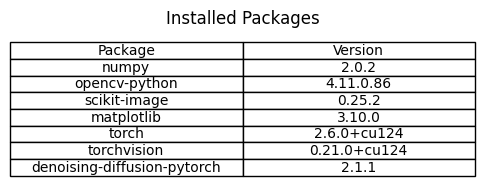

In [1]:
# Step 1: Install Dependencies and Set Up Environment
!pip install denoising-diffusion-pytorch

import cv2
import numpy as np
import matplotlib.pyplot as plt
from skimage.metrics import peak_signal_noise_ratio, structural_similarity, mean_squared_error
import os
import torch
from PIL import Image
from torch.utils.data import Dataset, DataLoader
import torchvision.transforms as transforms
import pandas as pd
from denoising_diffusion_pytorch import Unet, GaussianDiffusion, Trainer

# Enable inline plotting
%matplotlib inline

# Create output directories
os.makedirs("denoise_steps", exist_ok=True)
os.makedirs("comparisons", exist_ok=True)
os.makedirs("bsr_images", exist_ok=True)

# Verify GPU
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")

# Output: Table of installed packages
import pkg_resources
packages = ['numpy', 'opencv-python', 'scikit-image', 'matplotlib', 'torch', 'torchvision', 'denoising-diffusion-pytorch']
installed = {pkg: pkg_resources.get_distribution(pkg).version for pkg in packages}
df = pd.DataFrame(list(installed.items()), columns=['Package', 'Version'])
print("\nInstalled Packages:")
print(df)

# Plot table
plt.figure(figsize=(6, 2))
plt.table(cellText=df.values, colLabels=df.columns, loc='center', cellLoc='center')
plt.axis('off')
plt.title("Installed Packages")
plt.savefig("comparisons/step1_packages.png")
plt.show()

Please upload Barbara.jpg and bee_2.jpg


Saving bee_2.jpg to bee_2.jpg
Saving Barbara.jpg to Barbara.jpg

Loaded Images:
     Image       Shape
0  Barbara  (512, 512)
1      Bee  (443, 590)


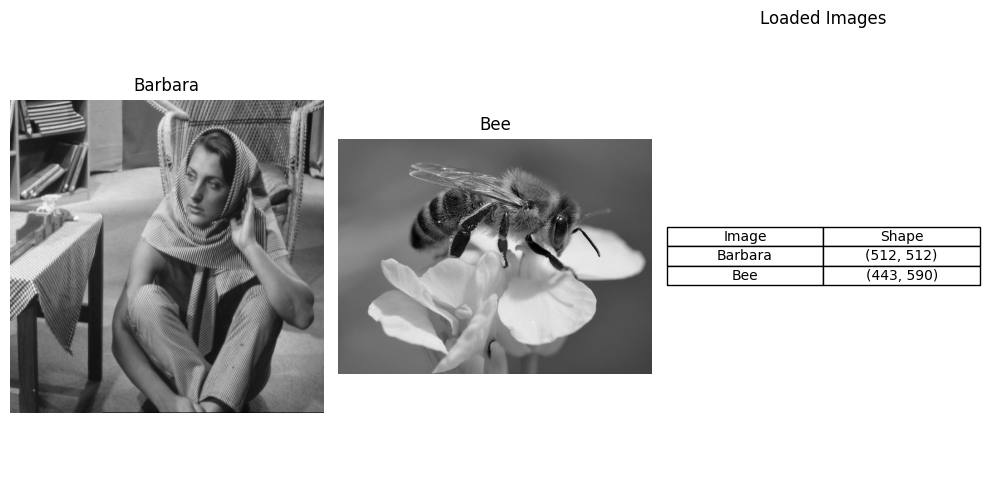

In [2]:
# Step 2: Upload and Load Images
from google.colab import files

# Upload Barbara and Bee images
print("Please upload Barbara.jpg and bee_2.jpg")
uploaded = files.upload()

# Define image paths
image_paths = {
    "Barbara": "/content/Barbara.jpg",
    "Bee": "/content/bee_2.jpg",
}

# Load images
images = {}
for name, path in image_paths.items():
    img = cv2.imread(path, cv2.IMREAD_GRAYSCALE)
    if img is None:
        print(f"Error: Failed to load {name} from {path}")
    else:
        images[name] = img

# Exit if no images loaded
if not images:
    print("Error: No images loaded. Exiting.")
    import sys
    sys.exit(1)

# Output: Table of loaded images
df = pd.DataFrame([(name, img.shape) for name, img in images.items()], columns=['Image', 'Shape'])
print("\nLoaded Images:")
print(df)

# Visualize loaded images and table
plt.figure(figsize=(10, 5))
for i, (name, img) in enumerate(images.items(), 1):
    plt.subplot(1, len(images) + 1, i)
    plt.imshow(img, cmap='gray')
    plt.title(name)
    plt.axis('off')
plt.subplot(1, len(images) + 1, len(images) + 1)
plt.table(cellText=df.values, colLabels=df.columns, loc='center', cellLoc='center')
plt.axis('off')
plt.title("Loaded Images")
plt.tight_layout()
plt.savefig("comparisons/step2_images.png")
plt.show()


Noisy Image Metrics:
     Image  Sigma       PSNR      SSIM
0  Barbara     10  28.143954  0.702668
1  Barbara     20  22.154636  0.458626
2  Barbara     30  18.734040  0.322182
3  Barbara     40  16.371054  0.238332
4      Bee     10  28.139743  0.535631
5      Bee     20  22.197042  0.292364
6      Bee     30  18.764805  0.192623
7      Bee     40  16.413861  0.139676


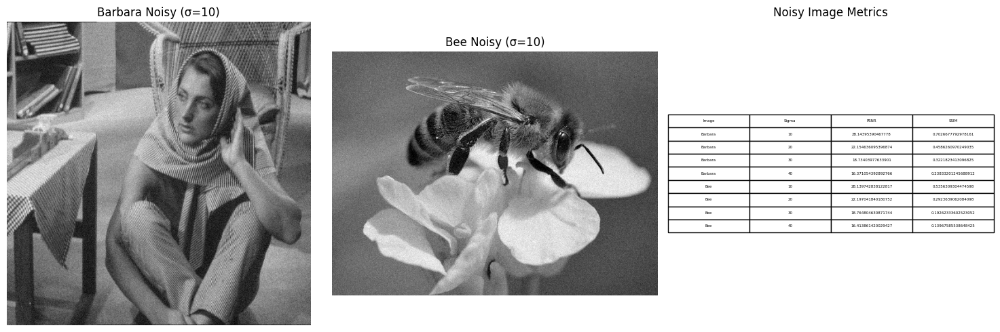

In [ ]:
# Step 3: Normalize Images and Add Noise
sigma_noise_levels = [10, 20, 30, 40]
noisy_images = {}

# Normalize and add noise
for name in images:
    images[name] = images[name].astype(float) / 255.0
    noisy_images[name] = {}
    for sigma in sigma_noise_levels:
        scaled_sigma = sigma / 255.0
        noise = np.random.normal(0, scaled_sigma, images[name].shape)
        noisy_images[name][sigma] = np.clip(images[name] + noise, 0, 1)
        cv2.imwrite(f"noisy_{name}_sigma_{sigma}.png", (noisy_images[name][sigma] * 255).astype(np.uint8))

# Output: Table of noisy image metrics
metrics = []
for name in images:
    for sigma in sigma_noise_levels:
        psnr_val = peak_signal_noise_ratio(images[name], noisy_images[name][sigma], data_range=1.0)
        ssim_val = structural_similarity(images[name], noisy_images[name][sigma], data_range=1.0)
        metrics.append([name, sigma, psnr_val, ssim_val])
df = pd.DataFrame(metrics, columns=['Image', 'Sigma', 'PSNR', 'SSIM'])
print("\nNoisy Image Metrics:")
print(df)

# Visualize noisy images and table (example for σ=10)
plt.figure(figsize=(15, 5))
for i, name in enumerate(images, 1):
    plt.subplot(1, len(images) + 1, i)
    plt.imshow(noisy_images[name][10], cmap='gray')
    plt.title(f"{name} Noisy (σ=10)")
    plt.axis('off')
plt.subplot(1, len(images) + 1, len(images) + 1)
plt.table(cellText=df.values, colLabels=df.columns, loc='center', cellLoc='center')
plt.axis('off')
plt.title("Noisy Image Metrics")
plt.tight_layout()
plt.savefig("comparisons/step3_noisy_metrics.png")
plt.show()

PDE Functions Defined: p, q, compute_gradient, double_phase_operator, solve_pde

PDE Function Descriptions:
                Function                      Description
0                      p  Computes variable exponent p(x)
1                      q  Computes variable exponent q(x)
2       compute_gradient       Calculates image gradients
3  double_phase_operator     Computes PDE flux divergence
4              solve_pde         Solves PDE for denoising


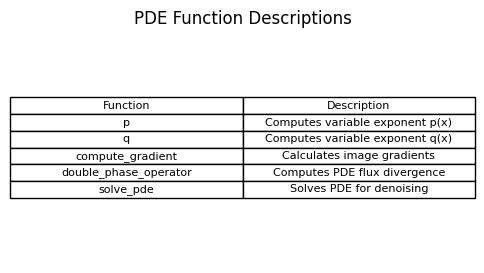

In [ ]:
# Step 4: Define PDE Denoising Functions
def p(x, k1):
    return 1 + 1 / (1 + k1 * np.linalg.norm(x)**2)

def q(x, k2):
    return 1 + 1 / (1 + k2 * np.linalg.norm(x)**2)

def compute_gradient(u):
    grad_x = np.gradient(u, axis=1)
    grad_y = np.gradient(u, axis=0)
    return grad_x, grad_y

def double_phase_operator(u, X, Y, k1, k2):
    grad_x, grad_y = compute_gradient(u)
    grad_norm = np.sqrt(grad_x**2 + grad_y**2 + 1e-4)
    p_vals = p(np.stack([X, Y], axis=-1), k1)
    q_vals = q(np.stack([X, Y], axis=-1), k2)
    flux_x = (grad_norm**(p_vals-2) + grad_norm**(q_vals-2)) * grad_x
    flux_y = (grad_norm**(p_vals-2) + grad_norm**(q_vals-2)) * grad_y
    div_x = np.gradient(flux_x, axis=1)
    div_y = np.gradient(flux_y, axis=0)
    return div_x + div_y

def solve_pde(noisy_image, k1=1.0, k2=1.0, T=0.1, dt=0.00005, h=1.0, image_name="", sigma=0):
    u = noisy_image.copy()
    height, width = u.shape
    x = np.arange(0, width, h)
    y = np.arange(0, height, h)
    X, Y = np.meshgrid(x, y)
    num_iterations = int(T / dt)
    prev_u = u.copy()

    for t in range(num_iterations):
        diffusion_term = double_phase_operator(u, X, Y, k1, k2)
        u -= dt * diffusion_term
        u = np.clip(u, 0, 1)
        if np.any(np.isnan(u)) or np.any(np.isinf(u)):
            print(f"Warning: Invalid values at iteration {t} for {image_name}, σ={sigma}")
            return u
        if t % 100 == 0 and t > 0:
            diff = np.mean(np.abs(u - prev_u))
            if diff < 1e-4:
                print(f"Early stopping at iteration {t} for {image_name}, σ={sigma}")
                break
            prev_u = u.copy()
        if t % 500 == 0:
            plt.figure(figsize=(5, 5))
            plt.imshow(u, cmap='gray')
            plt.title(f"{image_name}, σ={sigma}, Iteration {t}")
            plt.axis('off')
            plt.savefig(f"denoise_steps/denoise_{image_name}_sigma_{sigma}_iter_{t}.png")
            plt.close()

    cv2.imwrite(f"denoise_{image_name}_sigma_{sigma}_pde.png", (u * 255).astype(np.uint8))
    return u

# Output: Function definitions (no runtime output)
print("PDE Functions Defined: p, q, compute_gradient, double_phase_operator, solve_pde")

# Visualize function descriptions (table)
df = pd.DataFrame([
    ['p', 'Computes variable exponent p(x)'],
    ['q', 'Computes variable exponent q(x)'],
    ['compute_gradient', 'Calculates image gradients'],
    ['double_phase_operator', 'Computes PDE flux divergence'],
    ['solve_pde', 'Solves PDE for denoising']
], columns=['Function', 'Description'])
print("\nPDE Function Descriptions:")
print(df)

plt.figure(figsize=(6, 3))
plt.table(cellText=df.values, colLabels=df.columns, loc='center', cellLoc='center')
plt.axis('off')
plt.title("PDE Function Descriptions")
plt.savefig("comparisons/step4_functions.png")
plt.show()

Processing Barbara, σ=10
Processing Barbara, σ=20
Processing Barbara, σ=30
Processing Barbara, σ=40
Processing Bee, σ=10
Processing Bee, σ=20
Processing Bee, σ=30
Processing Bee, σ=40

PDE Denoised Metrics:
     Image  Sigma       PSNR      SSIM
0  Barbara     10  12.705440  0.218538
1  Barbara     20  11.763984  0.170180
2  Barbara     30  10.961476  0.135388
3  Barbara     40  10.295342  0.110453
4      Bee     10  12.394043  0.108295
5      Bee     20  11.587353  0.087056
6      Bee     30  10.851857  0.071463
7      Bee     40  10.227672  0.060001


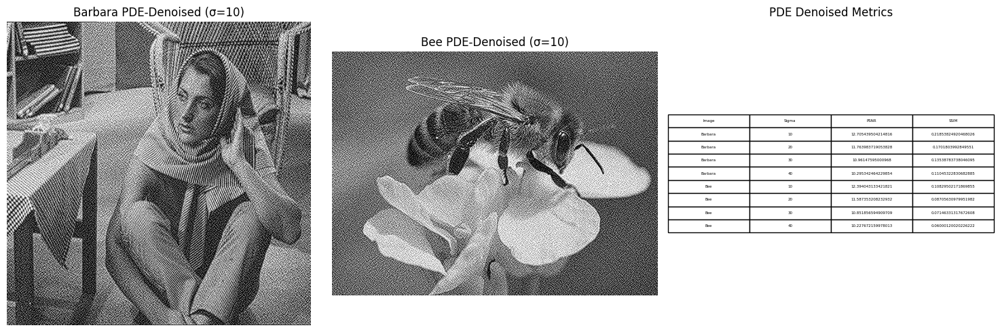

In [ ]:
# Step 5: Apply PDE Denoising
pde_denoised_images = {}
for name in images:
    pde_denoised_images[name] = {}
    for sigma in sigma_noise_levels:
        print(f"Processing {name}, σ={sigma}")
        pde_denoised_images[name][sigma] = solve_pde(
            noisy_images[name][sigma], k1=1.0, k2=1.0, T=0.1, dt=0.00005,
            image_name=name, sigma=sigma
        )

# Output: Table of PDE denoising metrics
metrics = []
for name in images:
    for sigma in sigma_noise_levels:
        psnr_val = peak_signal_noise_ratio(images[name], pde_denoised_images[name][sigma], data_range=1.0)
        ssim_val = structural_similarity(images[name], pde_denoised_images[name][sigma], data_range=1.0)
        metrics.append([name, sigma, psnr_val, ssim_val])
df = pd.DataFrame(metrics, columns=['Image', 'Sigma', 'PSNR', 'SSIM'])
print("\nPDE Denoised Metrics:")
print(df)

# Visualize PDE-denoised images (σ=10) and table
plt.figure(figsize=(15, 5))
for i, name in enumerate(images, 1):
    plt.subplot(1, len(images) + 1, i)
    plt.imshow(pde_denoised_images[name][10], cmap='gray')
    plt.title(f"{name} PDE-Denoised (σ=10)")
    plt.axis('off')
plt.subplot(1, len(images) + 1, len(images) + 1)
plt.table(cellText=df.values, colLabels=df.columns, loc='center', cellLoc='center')
plt.axis('off')
plt.title("PDE Denoised Metrics")
plt.tight_layout()
plt.savefig("comparisons/step5_pde_metrics.png")
plt.show()

BSR Dataset loaded successfully

BSR Dataset Info:
     Dataset  Num Images                           Path
0  BSR Train         200  BSR/BSDS500/data/images/train


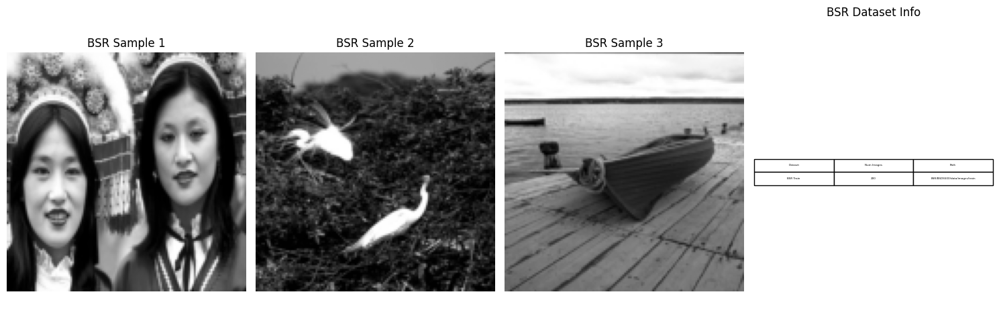

In [ ]:
# Step 6: Prepare Images for Diffusion Model
import glob

# Download and extract BSR dataset
try:
    if not os.path.exists('BSR_bsds500.tgz'):
        !wget https://www2.eecs.berkeley.edu/Research/Projects/CS/vision/grouping/BSR/BSR_bsds500.tgz
    if not os.path.exists('BSR'):
        !tar xzf BSR_bsds500.tgz
    print("BSR Dataset loaded successfully")
except Exception as e:
    print(f"Error loading dataset: {e}")
    import sys
    sys.exit(1)

# Custom dataset class
class BSRDataset(Dataset):
    def __init__(self, root_dir, transform=None):
        self.image_paths = glob.glob(os.path.join(root_dir, '*.jpg'))
        self.transform = transform
    def __len__(self):
        return len(self.image_paths)
    def __getitem__(self, idx):
        img_path = self.image_paths[idx]
        image = Image.open(img_path).convert('L')  # Grayscale
        if self.transform:
            image = self.transform(image)
        return image

# Define transforms
transform = transforms.Compose([
    transforms.Resize((128, 128)),
    transforms.ToTensor()
])

# Load BSR dataset (train folder)
bsr_train_path = 'BSR/BSDS500/data/images/train'
train_dataset = BSRDataset(bsr_train_path, transform=transform)
train_dataloader = DataLoader(train_dataset, batch_size=16, shuffle=True)

# Save transformed images to bsr_images for diffusion
os.makedirs("bsr_images", exist_ok=True)
for i, img in enumerate(train_dataset):
    img_np = img.squeeze().numpy() * 255.0
    Image.fromarray(img_np.astype(np.uint8)).save(f"bsr_images/train_{i}.png")

# Output: Table of dataset info
num_images = len(train_dataset)
df = pd.DataFrame([
    ['BSR Train', num_images, bsr_train_path]
], columns=['Dataset', 'Num Images', 'Path'])
print("\nBSR Dataset Info:")
print(df)

# Visualize sample BSR images and table
sample_images = [train_dataset[i] for i in range(min(3, num_images))]
plt.figure(figsize=(15, 5))
for i in range(len(sample_images)):
    plt.subplot(1, 4, i + 1)
    plt.imshow(sample_images[i].squeeze(), cmap='gray')
    plt.title(f"BSR Sample {i+1}")
    plt.axis('off')
plt.subplot(1, 4, 4)
plt.table(cellText=df.values, colLabels=df.columns, loc='center', cellLoc='center')
plt.axis('off')
plt.title("BSR Dataset Info")
plt.tight_layout()
plt.savefig("comparisons/step6_bsr_info.png")
plt.show()

Non-A100 GPU detected, using math or mem efficient attention if input tensor is on cuda
Starting diffusion model training...


  0%|          | 0/1000 [00:00<?, ?it/s]

/usr/lib/python3.11/contextlib.py:105: FutureWarning: `torch.backends.cuda.sdp_kernel()` is deprecated. In the future, this context manager will be removed. Please see `torch.nn.attention.sdpa_kernel()` for the new context manager, with updated signature.
  self.gen = func(*args, **kwds)


sampling loop time step:   0%|          | 0/50 [00:00<?, ?it/s]

sampling loop time step:   0%|          | 0/50 [00:00<?, ?it/s]

training complete
Diffusion model training completed.

Diffusion Model Summary:
   Component                                       Config
0      U-Net          dim=64, mults=(1,2,4,8), channels=1
1  Diffusion  image_size=128, timesteps=1000, sampling=50
2    Trainer                    batch_size=16, steps=1000


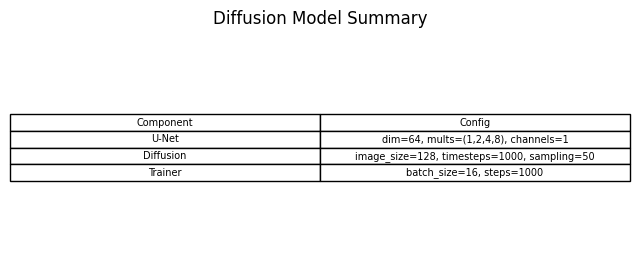

In [ ]:
# Step 7: Train Diffusion Model
model = Unet(
    dim=64,
    dim_mults=(1, 2, 4, 8),
    flash_attn=True,
    channels=1  # Grayscale
)

diffusion = GaussianDiffusion(
    model,
    image_size=128,
    timesteps=1000,
    sampling_timesteps=50
)

trainer = Trainer(
    diffusion,
    'bsr_images',
    train_batch_size=16,
    train_lr=8e-5,
    train_num_steps=1000,  # Reduced for Colab
    gradient_accumulate_every=2,
    ema_decay=0.995,
    amp=True,
    calculate_fid=False
)

print("Starting diffusion model training...")
trainer.train()
print("Diffusion model training completed.")

# Output: Function for diffusion model summary
def diffusion_summary():
    return pd.DataFrame([
        ['U-Net', 'dim=64, mults=(1,2,4,8), channels=1'],
        ['Diffusion', 'image_size=128, timesteps=1000, sampling=50'],
        ['Trainer', 'batch_size=16, steps=1000']
    ], columns=['Component', 'Config'])

df = diffusion_summary()
print("\nDiffusion Model Summary:")
print(df)

plt.figure(figsize=(8, 3))
plt.table(cellText=df.values, colLabels=df.columns, loc='center', cellLoc='center')
plt.axis('off')
plt.title("Diffusion Model Summary")
plt.savefig("comparisons/step7_diffusion_summary.png")
plt.show()

Preprocessed tensor shape: torch.Size([1, 1, 128, 128]), device: cuda:0
Inferring hybrid output for Barbara, σ=10
Sampling step 49, img shape: torch.Size([1, 1, 128, 128])
Sampling step 48, img shape: torch.Size([1, 1, 128, 128])
Sampling step 47, img shape: torch.Size([1, 1, 128, 128])
Sampling step 46, img shape: torch.Size([1, 1, 128, 128])
Sampling step 45, img shape: torch.Size([1, 1, 128, 128])
Sampling step 44, img shape: torch.Size([1, 1, 128, 128])
Sampling step 43, img shape: torch.Size([1, 1, 128, 128])
Sampling step 42, img shape: torch.Size([1, 1, 128, 128])
Sampling step 41, img shape: torch.Size([1, 1, 128, 128])
Sampling step 40, img shape: torch.Size([1, 1, 128, 128])
Sampling step 39, img shape: torch.Size([1, 1, 128, 128])
Sampling step 38, img shape: torch.Size([1, 1, 128, 128])
Sampling step 37, img shape: torch.Size([1, 1, 128, 128])
Sampling step 36, img shape: torch.Size([1, 1, 128, 128])
Sampling step 35, img shape: torch.Size([1, 1, 128, 128])
Sampling step 34

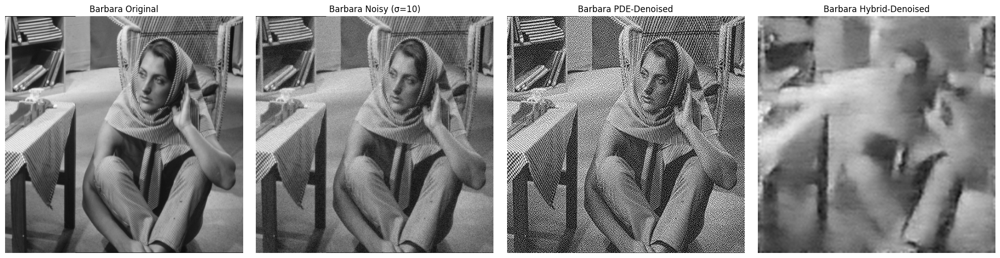

Preprocessed tensor shape: torch.Size([1, 1, 128, 128]), device: cuda:0
Inferring hybrid output for Barbara, σ=20
Sampling step 49, img shape: torch.Size([1, 1, 128, 128])
Sampling step 48, img shape: torch.Size([1, 1, 128, 128])
Sampling step 47, img shape: torch.Size([1, 1, 128, 128])
Sampling step 46, img shape: torch.Size([1, 1, 128, 128])
Sampling step 45, img shape: torch.Size([1, 1, 128, 128])
Sampling step 44, img shape: torch.Size([1, 1, 128, 128])
Sampling step 43, img shape: torch.Size([1, 1, 128, 128])
Sampling step 42, img shape: torch.Size([1, 1, 128, 128])
Sampling step 41, img shape: torch.Size([1, 1, 128, 128])
Sampling step 40, img shape: torch.Size([1, 1, 128, 128])
Sampling step 39, img shape: torch.Size([1, 1, 128, 128])
Sampling step 38, img shape: torch.Size([1, 1, 128, 128])
Sampling step 37, img shape: torch.Size([1, 1, 128, 128])
Sampling step 36, img shape: torch.Size([1, 1, 128, 128])
Sampling step 35, img shape: torch.Size([1, 1, 128, 128])
Sampling step 34

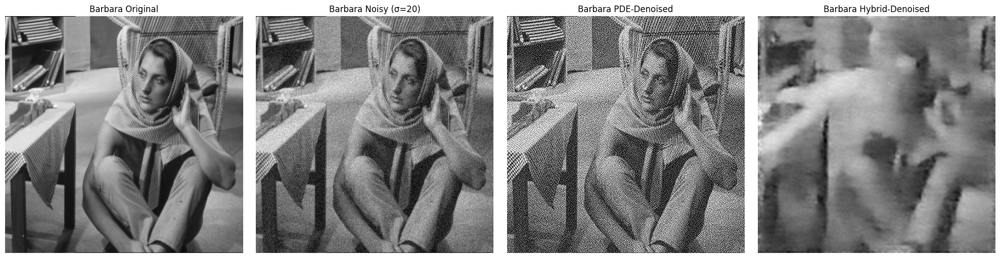

Preprocessed tensor shape: torch.Size([1, 1, 128, 128]), device: cuda:0
Inferring hybrid output for Barbara, σ=30
Sampling step 49, img shape: torch.Size([1, 1, 128, 128])
Sampling step 48, img shape: torch.Size([1, 1, 128, 128])
Sampling step 47, img shape: torch.Size([1, 1, 128, 128])
Sampling step 46, img shape: torch.Size([1, 1, 128, 128])
Sampling step 45, img shape: torch.Size([1, 1, 128, 128])
Sampling step 44, img shape: torch.Size([1, 1, 128, 128])
Sampling step 43, img shape: torch.Size([1, 1, 128, 128])
Sampling step 42, img shape: torch.Size([1, 1, 128, 128])
Sampling step 41, img shape: torch.Size([1, 1, 128, 128])
Sampling step 40, img shape: torch.Size([1, 1, 128, 128])
Sampling step 39, img shape: torch.Size([1, 1, 128, 128])
Sampling step 38, img shape: torch.Size([1, 1, 128, 128])
Sampling step 37, img shape: torch.Size([1, 1, 128, 128])
Sampling step 36, img shape: torch.Size([1, 1, 128, 128])
Sampling step 35, img shape: torch.Size([1, 1, 128, 128])
Sampling step 34

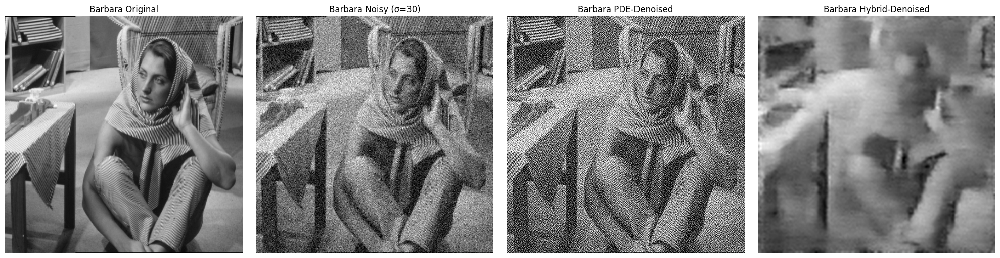

Preprocessed tensor shape: torch.Size([1, 1, 128, 128]), device: cuda:0
Inferring hybrid output for Barbara, σ=40
Sampling step 49, img shape: torch.Size([1, 1, 128, 128])
Sampling step 48, img shape: torch.Size([1, 1, 128, 128])
Sampling step 47, img shape: torch.Size([1, 1, 128, 128])
Sampling step 46, img shape: torch.Size([1, 1, 128, 128])
Sampling step 45, img shape: torch.Size([1, 1, 128, 128])
Sampling step 44, img shape: torch.Size([1, 1, 128, 128])
Sampling step 43, img shape: torch.Size([1, 1, 128, 128])
Sampling step 42, img shape: torch.Size([1, 1, 128, 128])
Sampling step 41, img shape: torch.Size([1, 1, 128, 128])
Sampling step 40, img shape: torch.Size([1, 1, 128, 128])
Sampling step 39, img shape: torch.Size([1, 1, 128, 128])
Sampling step 38, img shape: torch.Size([1, 1, 128, 128])
Sampling step 37, img shape: torch.Size([1, 1, 128, 128])
Sampling step 36, img shape: torch.Size([1, 1, 128, 128])
Sampling step 35, img shape: torch.Size([1, 1, 128, 128])
Sampling step 34

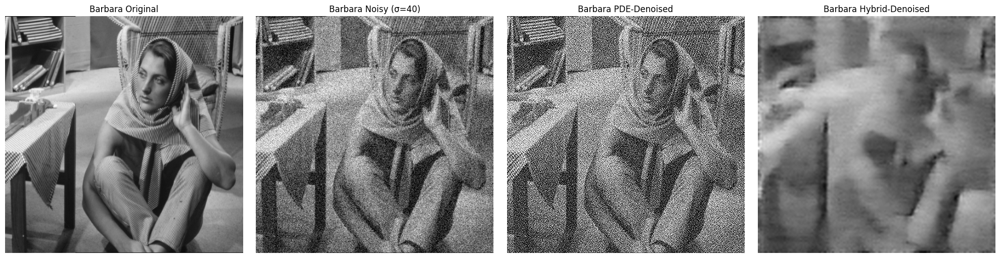

Preprocessed tensor shape: torch.Size([1, 1, 128, 128]), device: cuda:0
Inferring hybrid output for Bee, σ=10
Sampling step 49, img shape: torch.Size([1, 1, 128, 128])
Sampling step 48, img shape: torch.Size([1, 1, 128, 128])
Sampling step 47, img shape: torch.Size([1, 1, 128, 128])
Sampling step 46, img shape: torch.Size([1, 1, 128, 128])
Sampling step 45, img shape: torch.Size([1, 1, 128, 128])
Sampling step 44, img shape: torch.Size([1, 1, 128, 128])
Sampling step 43, img shape: torch.Size([1, 1, 128, 128])
Sampling step 42, img shape: torch.Size([1, 1, 128, 128])
Sampling step 41, img shape: torch.Size([1, 1, 128, 128])
Sampling step 40, img shape: torch.Size([1, 1, 128, 128])
Sampling step 39, img shape: torch.Size([1, 1, 128, 128])
Sampling step 38, img shape: torch.Size([1, 1, 128, 128])
Sampling step 37, img shape: torch.Size([1, 1, 128, 128])
Sampling step 36, img shape: torch.Size([1, 1, 128, 128])
Sampling step 35, img shape: torch.Size([1, 1, 128, 128])
Sampling step 34, im

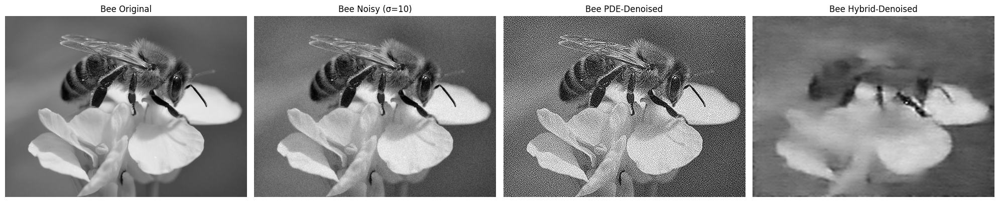

Preprocessed tensor shape: torch.Size([1, 1, 128, 128]), device: cuda:0
Inferring hybrid output for Bee, σ=20
Sampling step 49, img shape: torch.Size([1, 1, 128, 128])
Sampling step 48, img shape: torch.Size([1, 1, 128, 128])
Sampling step 47, img shape: torch.Size([1, 1, 128, 128])
Sampling step 46, img shape: torch.Size([1, 1, 128, 128])
Sampling step 45, img shape: torch.Size([1, 1, 128, 128])
Sampling step 44, img shape: torch.Size([1, 1, 128, 128])
Sampling step 43, img shape: torch.Size([1, 1, 128, 128])
Sampling step 42, img shape: torch.Size([1, 1, 128, 128])
Sampling step 41, img shape: torch.Size([1, 1, 128, 128])
Sampling step 40, img shape: torch.Size([1, 1, 128, 128])
Sampling step 39, img shape: torch.Size([1, 1, 128, 128])
Sampling step 38, img shape: torch.Size([1, 1, 128, 128])
Sampling step 37, img shape: torch.Size([1, 1, 128, 128])
Sampling step 36, img shape: torch.Size([1, 1, 128, 128])
Sampling step 35, img shape: torch.Size([1, 1, 128, 128])
Sampling step 34, im

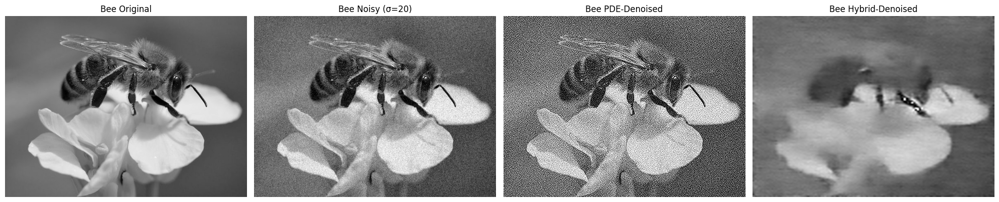

Preprocessed tensor shape: torch.Size([1, 1, 128, 128]), device: cuda:0
Inferring hybrid output for Bee, σ=30
Sampling step 49, img shape: torch.Size([1, 1, 128, 128])
Sampling step 48, img shape: torch.Size([1, 1, 128, 128])
Sampling step 47, img shape: torch.Size([1, 1, 128, 128])
Sampling step 46, img shape: torch.Size([1, 1, 128, 128])
Sampling step 45, img shape: torch.Size([1, 1, 128, 128])
Sampling step 44, img shape: torch.Size([1, 1, 128, 128])
Sampling step 43, img shape: torch.Size([1, 1, 128, 128])
Sampling step 42, img shape: torch.Size([1, 1, 128, 128])
Sampling step 41, img shape: torch.Size([1, 1, 128, 128])
Sampling step 40, img shape: torch.Size([1, 1, 128, 128])
Sampling step 39, img shape: torch.Size([1, 1, 128, 128])
Sampling step 38, img shape: torch.Size([1, 1, 128, 128])
Sampling step 37, img shape: torch.Size([1, 1, 128, 128])
Sampling step 36, img shape: torch.Size([1, 1, 128, 128])
Sampling step 35, img shape: torch.Size([1, 1, 128, 128])
Sampling step 34, im

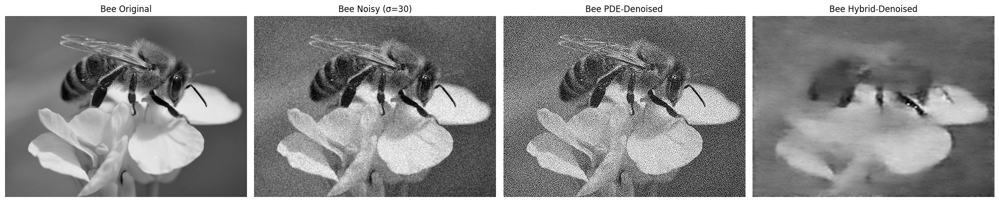

Preprocessed tensor shape: torch.Size([1, 1, 128, 128]), device: cuda:0
Inferring hybrid output for Bee, σ=40
Sampling step 49, img shape: torch.Size([1, 1, 128, 128])
Sampling step 48, img shape: torch.Size([1, 1, 128, 128])
Sampling step 47, img shape: torch.Size([1, 1, 128, 128])
Sampling step 46, img shape: torch.Size([1, 1, 128, 128])
Sampling step 45, img shape: torch.Size([1, 1, 128, 128])
Sampling step 44, img shape: torch.Size([1, 1, 128, 128])
Sampling step 43, img shape: torch.Size([1, 1, 128, 128])
Sampling step 42, img shape: torch.Size([1, 1, 128, 128])
Sampling step 41, img shape: torch.Size([1, 1, 128, 128])
Sampling step 40, img shape: torch.Size([1, 1, 128, 128])
Sampling step 39, img shape: torch.Size([1, 1, 128, 128])
Sampling step 38, img shape: torch.Size([1, 1, 128, 128])
Sampling step 37, img shape: torch.Size([1, 1, 128, 128])
Sampling step 36, img shape: torch.Size([1, 1, 128, 128])
Sampling step 35, img shape: torch.Size([1, 1, 128, 128])
Sampling step 34, im

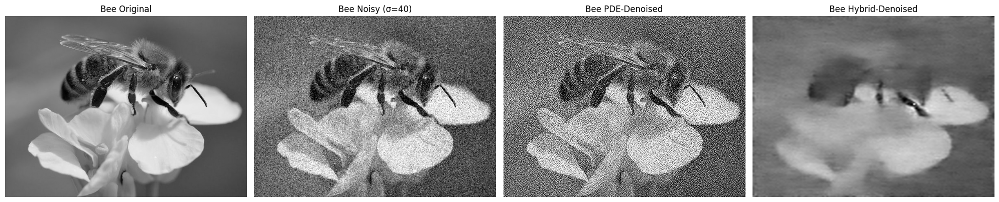


Final Denoising Metrics:
      Image  Sigma  Method       PSNR      SSIM
0   Barbara     10   Noisy  28.143954  0.702668
1   Barbara     10     PDE  12.705440  0.218538
2   Barbara     10  Hybrid  21.030221  0.493371
3   Barbara     20   Noisy  22.154636  0.458626
4   Barbara     20     PDE  11.763984  0.170180
5   Barbara     20  Hybrid  20.565894  0.477498
6   Barbara     30   Noisy  18.734040  0.322182
7   Barbara     30     PDE  10.961476  0.135388
8   Barbara     30  Hybrid  20.217760  0.470767
9   Barbara     40   Noisy  16.371054  0.238332
10  Barbara     40     PDE  10.295342  0.110453
11  Barbara     40  Hybrid  19.696762  0.459436
12      Bee     10   Noisy  28.139743  0.535631
13      Bee     10     PDE  12.394043  0.108295
14      Bee     10  Hybrid  22.809102  0.718799
15      Bee     20   Noisy  22.197042  0.292364
16      Bee     20     PDE  11.587353  0.087056
17      Bee     20  Hybrid  22.164354  0.712038
18      Bee     30   Noisy  18.764805  0.192623
19      Bee   

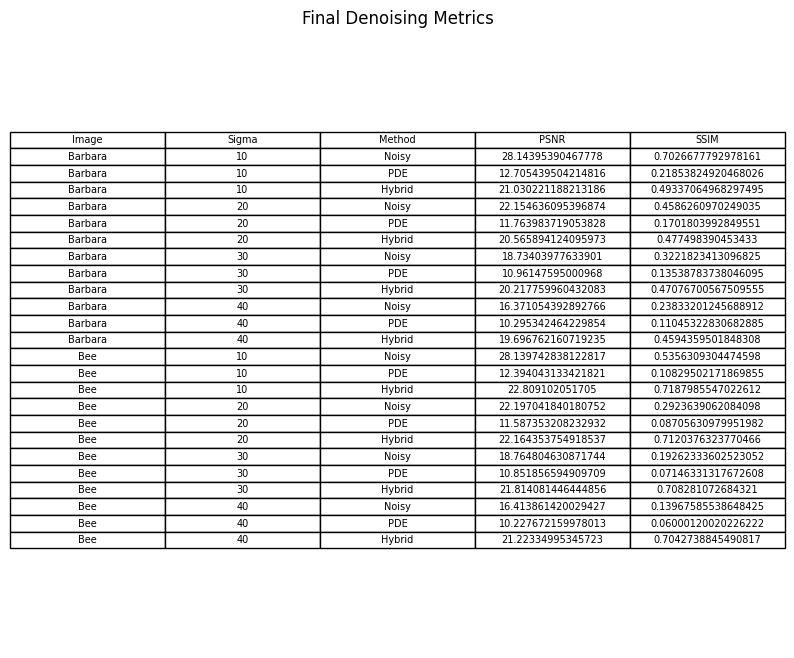

In [ ]:
# Step 8: Hybrid Inference and Visualization
import matplotlib.pyplot as plt
from skimage.metrics import peak_signal_noise_ratio, structural_similarity, mean_squared_error
import torch
from PIL import Image
import numpy as np
import pandas as pd

# Ensure matplotlib inline for Colab
%matplotlib inline

# Preprocess function for diffusion model
def preprocess_for_diffusion(image, size=128):
    img = Image.fromarray((image * 255).astype(np.uint8)).convert('L')
    img = img.resize((size, size), Image.LANCZOS)
    img = np.array(img).astype(np.float32) / 255.0
    img = torch.from_numpy(img).unsqueeze(0).unsqueeze(0).to(device)
    print(f"Preprocessed tensor shape: {img.shape}, device: {img.device}")
    return img

# Custom sampling function with scalar timestep
def custom_sample(diffusion, img, timesteps=50):
    diffusion.model.eval()
    img = img.to(device)
    batch_size = img.shape[0]
    for t in reversed(range(timesteps)):
        # Pass t as a tensor of shape (batch_size,)
        # MODIFIED: Changed to torch.tensor
        # t_tensor = torch.tensor([t] * batch_size, device=device, dtype=torch.long)
        img, *_ = diffusion.p_sample(img, t)  # Unpack the tuple, keep only the sample
        print(f"Sampling step {t}, img shape: {img.shape}")
    return img

# Hybrid inference and visualization
results = {}
diffusion.model.to(device)  # Ensure model is on GPU
diffusion.model.eval()     # Set to evaluation mode
for name in images:
    results[name] = {}
    for sigma in sigma_noise_levels:
        noisy_img = noisy_images[name][sigma]
        pde_img = pde_denoised_images[name][sigma]
        clean_img = images[name]
        # Diffusion inference
        pde_img_resized = preprocess_for_diffusion(pde_img)
        print(f"Inferring hybrid output for {name}, σ={sigma}")
        with torch.no_grad():
            hybrid_img = custom_sample(diffusion, pde_img_resized, timesteps=diffusion.sampling_timesteps)
        hybrid_img = hybrid_img.squeeze().cpu().numpy()
        print(f"Hybrid output shape: {hybrid_img.shape}")
        # Resize back to original size
        hybrid_img_pil = Image.fromarray((hybrid_img * 255).astype(np.uint8))
        hybrid_img_pil = hybrid_img_pil.resize((clean_img.shape[1], clean_img.shape[0]), Image.LANCZOS)
        hybrid_img = np.array(hybrid_img_pil).astype(np.float32) / 255.0
        # Metrics
        results[name][sigma] = {
            "Noisy": {
                "PSNR": peak_signal_noise_ratio(clean_img, noisy_img, data_range=1.0),
                "SSIM": structural_similarity(clean_img, noisy_img, data_range=1.0)
            },
            "PDE": {
                "PSNR": peak_signal_noise_ratio(clean_img, pde_img, data_range=1.0),
                "SSIM": structural_similarity(clean_img, pde_img, data_range=1.0)
            },
            "Hybrid": {
                "PSNR": peak_signal_noise_ratio(clean_img, hybrid_img, data_range=1.0),
                "SSIM": structural_similarity(clean_img, hybrid_img, data_range=1.0)
            }
        }
        # Visualize
        plt.figure(figsize=(20, 5))
        plt.subplot(1, 4, 1)
        plt.imshow(clean_img, cmap='gray')
        plt.title(f"{name} Original")
        plt.axis('off')
        plt.subplot(1, 4, 2)
        plt.imshow(noisy_img, cmap='gray')
        plt.title(f"{name} Noisy (σ={sigma})")
        plt.axis('off')
        plt.subplot(1, 4, 3)
        plt.imshow(pde_img, cmap='gray')
        plt.title(f"{name} PDE-Denoised")
        plt.axis('off')
        plt.subplot(1, 4, 4)
        plt.imshow(hybrid_img, cmap='gray')
        plt.title(f"{name} Hybrid-Denoised")
        plt.axis('off')
        plt.tight_layout()
        plt.savefig(f"comparisons/comparison_{name}_sigma_{sigma}.png")
        plt.show()

# Output: Table of final metrics
metrics = []
for name in results:
    for sigma in results[name]:
        for method in results[name][sigma]:
            metrics.append([name, sigma, method, results[name][sigma][method]['PSNR'], results[name][sigma][method]['SSIM']])
df = pd.DataFrame(metrics, columns=['Image', 'Sigma', 'Method', 'PSNR', 'SSIM'])
print("\nFinal Denoising Metrics:")
print(df)

plt.figure(figsize=(10, 8))
plt.table(cellText=df.values, colLabels=df.columns, loc='center', cellLoc='center')
plt.axis('off')
plt.title("Final Denoising Metrics")
plt.savefig("comparisons/step8_final_metrics.png")
plt.show()

In [2]:
!pip install denoising_diffusion_pytorch

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 83.4/83.4 kB 4.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 3.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 126.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 98.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 60.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 1.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 5.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 12.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 5.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 106.8 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninstalli

Using device: cuda

Installed Packages:
                       Package       Version
0                        numpy         2.0.2
1                opencv-python     4.11.0.86
2                 scikit-image        0.25.2
3                   matplotlib        3.10.0
4                        torch   2.6.0+cu124
5                  torchvision  0.21.0+cu124
6  denoising-diffusion-pytorch         2.1.1


<ipython-input-1-0710e2e077cf>:27: DeprecationWarning: pkg_resources is deprecated as an API. See https://setuptools.pypa.io/en/latest/pkg_resources.html
  import pkg_resources


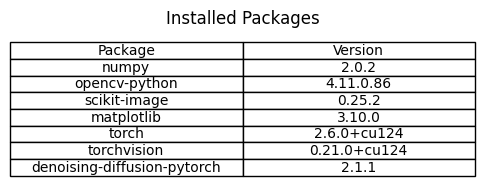

Please upload Barbara.jpg and bee_2.jpg


Saving bee_2.jpg to bee_2 (1).jpg
Saving Barbara.jpg to Barbara (1).jpg

Loaded Images:
     Image       Shape
0  Barbara  (512, 512)
1      Bee  (443, 590)


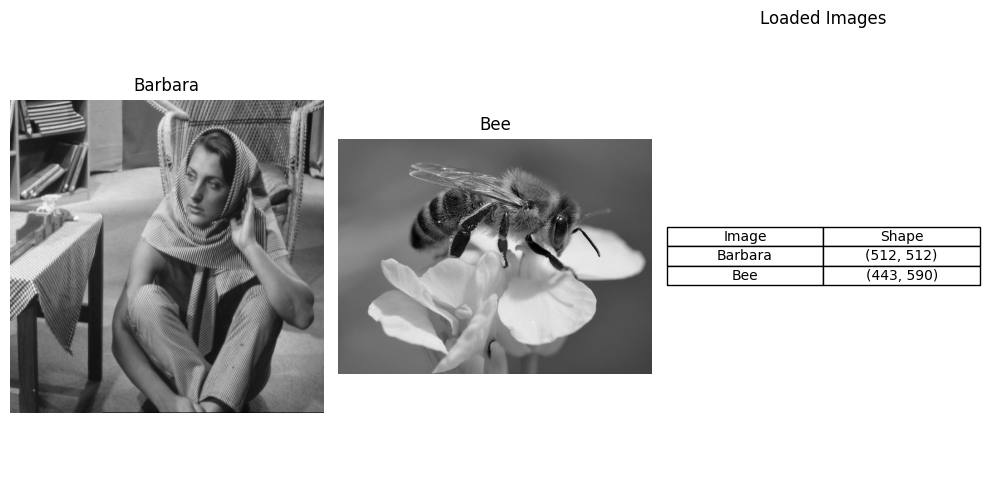


Noisy Image Metrics:
     Image  Sigma       PSNR      SSIM
0  Barbara     10  28.142605  0.702373
1  Barbara     20  22.136082  0.458155
2  Barbara     30  18.734845  0.322353
3  Barbara     40  16.369292  0.237207
4      Bee     10  28.138484  0.535475
5      Bee     20  22.184815  0.291761
6      Bee     30  18.787743  0.192947
7      Bee     40  16.403767  0.140504


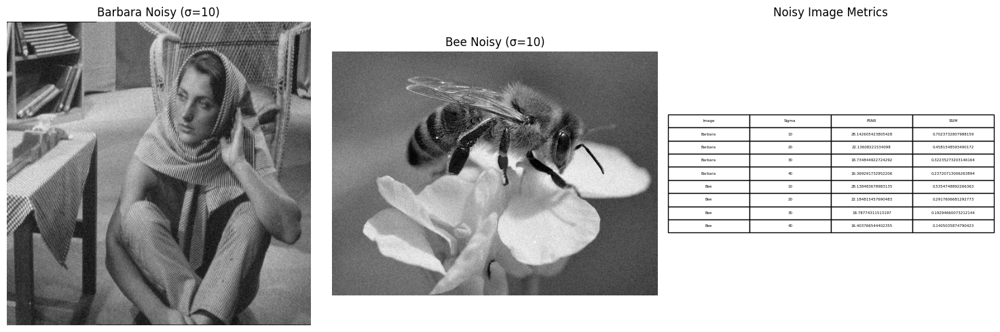

PDE Functions Defined: p, q, compute_gradient, double_phase_operator, solve_pde

PDE Function Descriptions:
                Function                      Description
0                      p  Computes variable exponent p(x)
1                      q  Computes variable exponent q(x)
2       compute_gradient       Calculates image gradients
3  double_phase_operator     Computes PDE flux divergence
4              solve_pde         Solves PDE for denoising


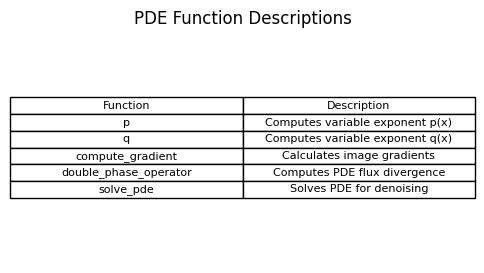

Processing Barbara, σ=10
Processing Barbara, σ=20
Processing Barbara, σ=30
Processing Barbara, σ=40
Processing Bee, σ=10
Processing Bee, σ=20
Processing Bee, σ=30
Processing Bee, σ=40

PDE Denoised Metrics:
     Image  Sigma       PSNR      SSIM
0  Barbara     10  12.701251  0.218595
1  Barbara     20  11.766438  0.170024
2  Barbara     30  10.967407  0.135606
3  Barbara     40  10.297489  0.110231
4      Bee     10  12.389259  0.108125
5      Bee     20  11.591600  0.087398
6      Bee     30  10.855551  0.071496
7      Bee     40  10.224659  0.060058


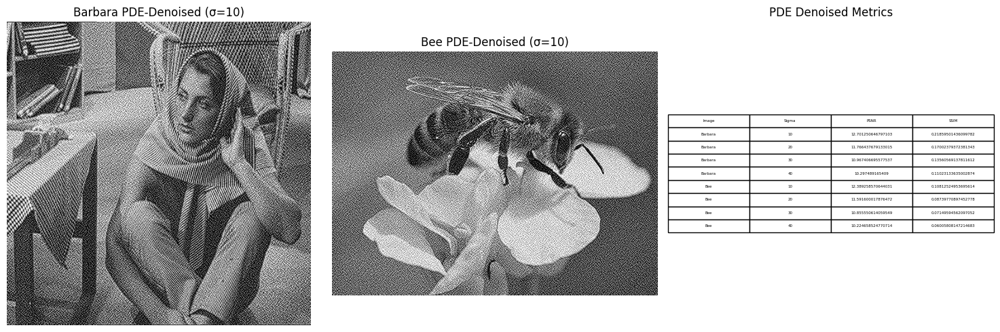

In [1]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from skimage.metrics import peak_signal_noise_ratio, structural_similarity, mean_squared_error
import os
import torch
from PIL import Image
from torch.utils.data import Dataset, DataLoader
import torchvision.transforms as transforms
import pandas as pd
from denoising_diffusion_pytorch import Unet, GaussianDiffusion, Trainer
import glob

# Enable inline plotting
%matplotlib inline

# Create output directories
os.makedirs("denoise_steps", exist_ok=True)
os.makedirs("comparisons", exist_ok=True)
os.makedirs("bsr_images", exist_ok=True)

# Verify GPU
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")

# Output: Table of installed packages
import pkg_resources
packages = ['numpy', 'opencv-python', 'scikit-image', 'matplotlib', 'torch', 'torchvision', 'denoising-diffusion-pytorch']
installed = {pkg: pkg_resources.get_distribution(pkg).version for pkg in packages}
df = pd.DataFrame(list(installed.items()), columns=['Package', 'Version'])
print("\nInstalled Packages:")
print(df)

# Plot table
plt.figure(figsize=(6, 2))
plt.table(cellText=df.values, colLabels=df.columns, loc='center', cellLoc='center')
plt.axis('off')
plt.title("Installed Packages")
plt.savefig("comparisons/step1_packages.png")
plt.show()

# Step 2: Upload and Load Images
from google.colab import files

# Upload Barbara and Bee images
print("Please upload Barbara.jpg and bee_2.jpg")
uploaded = files.upload()

# Define image paths
image_paths = {
    "Barbara": "/content/Barbara.jpg",
    "Bee": "/content/bee_2.jpg",
}

# Load images
images = {}
for name, path in image_paths.items():
    img = cv2.imread(path, cv2.IMREAD_GRAYSCALE)
    if img is None:
        print(f"Error: Failed to load {name} from {path}")
    else:
        images[name] = img

# Exit if no images loaded
if not images:
    print("Error: No images loaded. Exiting.")
    import sys
    sys.exit(1)

# Output: Table of loaded images
df = pd.DataFrame([(name, img.shape) for name, img in images.items()], columns=['Image', 'Shape'])
print("\nLoaded Images:")
print(df)

# Visualize loaded images and table
plt.figure(figsize=(10, 5))
for i, (name, img) in enumerate(images.items(), 1):
    plt.subplot(1, len(images) + 1, i)
    plt.imshow(img, cmap='gray')
    plt.title(name)
    plt.axis('off')
plt.subplot(1, len(images) + 1, len(images) + 1)
plt.table(cellText=df.values, colLabels=df.columns, loc='center', cellLoc='center')
plt.axis('off')
plt.title("Loaded Images")
plt.tight_layout()
plt.savefig("comparisons/step2_images.png")
plt.show()

# Step 3: Normalize Images and Add Noise
sigma_noise_levels = [10, 20, 30, 40]
noisy_images = {}

# Normalize and add noise
for name in images:
    images[name] = images[name].astype(float) / 255.0
    noisy_images[name] = {}
    for sigma in sigma_noise_levels:
        scaled_sigma = sigma / 255.0
        noise = np.random.normal(0, scaled_sigma, images[name].shape)
        noisy_images[name][sigma] = np.clip(images[name] + noise, 0, 1)
        cv2.imwrite(f"noisy_{name}_sigma_{sigma}.png", (noisy_images[name][sigma] * 255).astype(np.uint8))

# Output: Table of noisy image metrics
metrics = []
for name in images:
    for sigma in sigma_noise_levels:
        psnr_val = peak_signal_noise_ratio(images[name], noisy_images[name][sigma], data_range=1.0)
        ssim_val = structural_similarity(images[name], noisy_images[name][sigma], data_range=1.0)
        metrics.append([name, sigma, psnr_val, ssim_val])
df = pd.DataFrame(metrics, columns=['Image', 'Sigma', 'PSNR', 'SSIM'])
print("\nNoisy Image Metrics:")
print(df)

# Visualize noisy images and table (example for σ=10)
plt.figure(figsize=(15, 5))
for i, name in enumerate(images, 1):
    plt.subplot(1, len(images) + 1, i)
    plt.imshow(noisy_images[name][10], cmap='gray')
    plt.title(f"{name} Noisy (σ=10)")
    plt.axis('off')
plt.subplot(1, len(images) + 1, len(images) + 1)
plt.table(cellText=df.values, colLabels=df.columns, loc='center', cellLoc='center')
plt.axis('off')
plt.title("Noisy Image Metrics")
plt.tight_layout()
plt.savefig("comparisons/step3_noisy_metrics.png")
plt.show()

# Step 4: Define PDE Denoising Functions
def p(x, k1):
    return 1 + 1 / (1 + k1 * np.linalg.norm(x)**2)

def q(x, k2):
    return 1 + 1 / (1 + k2 * np.linalg.norm(x)**2)

def compute_gradient(u):
    grad_x = np.gradient(u, axis=1)
    grad_y = np.gradient(u, axis=0)
    return grad_x, grad_y

def double_phase_operator(u, X, Y, k1, k2):
    grad_x, grad_y = compute_gradient(u)
    grad_norm = np.sqrt(grad_x**2 + grad_y**2 + 1e-4)
    p_vals = p(np.stack([X, Y], axis=-1), k1)
    q_vals = q(np.stack([X, Y], axis=-1), k2)
    flux_x = (grad_norm**(p_vals-2) + grad_norm**(q_vals-2)) * grad_x
    flux_y = (grad_norm**(p_vals-2) + grad_norm**(q_vals-2)) * grad_y
    div_x = np.gradient(flux_x, axis=1)
    div_y = np.gradient(flux_y, axis=0)
    return div_x + div_y

def solve_pde(noisy_image, k1=1.0, k2=1.0, T=0.1, dt=0.00005, h=1.0, image_name="", sigma=0):
    u = noisy_image.copy()
    height, width = u.shape
    x = np.arange(0, width, h)
    y = np.arange(0, height, h)
    X, Y = np.meshgrid(x, y)
    num_iterations = int(T / dt)
    prev_u = u.copy()

    for t in range(num_iterations):
        diffusion_term = double_phase_operator(u, X, Y, k1, k2)
        u -= dt * diffusion_term
        u = np.clip(u, 0, 1)
        if np.any(np.isnan(u)) or np.any(np.isinf(u)):
            print(f"Warning: Invalid values at iteration {t} for {image_name}, σ={sigma}")
            return u
        if t % 100 == 0 and t > 0:
            diff = np.mean(np.abs(u - prev_u))
            if diff < 1e-4:
                print(f"Early stopping at iteration {t} for {image_name}, σ={sigma}")
                break
            prev_u = u.copy()
        if t % 500 == 0:
            plt.figure(figsize=(5, 5))
            plt.imshow(u, cmap='gray')
            plt.title(f"{image_name}, σ={sigma}, Iteration {t}")
            plt.axis('off')
            plt.savefig(f"denoise_steps/denoise_{image_name}_sigma_{sigma}_iter_{t}.png")
            plt.close()

    cv2.imwrite(f"denoise_{image_name}_sigma_{sigma}_pde.png", (u * 255).astype(np.uint8))
    return u

# Output: Function definitions
print("PDE Functions Defined: p, q, compute_gradient, double_phase_operator, solve_pde")

# Visualize function descriptions (table)
df = pd.DataFrame([
    ['p', 'Computes variable exponent p(x)'],
    ['q', 'Computes variable exponent q(x)'],
    ['compute_gradient', 'Calculates image gradients'],
    ['double_phase_operator', 'Computes PDE flux divergence'],
    ['solve_pde', 'Solves PDE for denoising']
], columns=['Function', 'Description'])
print("\nPDE Function Descriptions:")
print(df)

plt.figure(figsize=(6, 3))
plt.table(cellText=df.values, colLabels=df.columns, loc='center', cellLoc='center')
plt.axis('off')
plt.title("PDE Function Descriptions")
plt.savefig("comparisons/step4_functions.png")
plt.show()

# Step 5: Apply PDE Denoising
pde_denoised_images = {}
for name in images:
    pde_denoised_images[name] = {}
    for sigma in sigma_noise_levels:
        print(f"Processing {name}, σ={sigma}")
        pde_denoised_images[name][sigma] = solve_pde(
            noisy_images[name][sigma], k1=1.0, k2=1.0, T=0.1, dt=0.00005,
            image_name=name, sigma=sigma
        )

# Output: Table of PDE denoising metrics
metrics = []
for name in images:
    for sigma in sigma_noise_levels:
        psnr_val = peak_signal_noise_ratio(images[name], pde_denoised_images[name][sigma], data_range=1.0)
        ssim_val = structural_similarity(images[name], pde_denoised_images[name][sigma], data_range=1.0)
        metrics.append([name, sigma, psnr_val, ssim_val])
df = pd.DataFrame(metrics, columns=['Image', 'Sigma', 'PSNR', 'SSIM'])
print("\nPDE Denoised Metrics:")
print(df)

# Visualize PDE-denoised images (σ=10) and table
plt.figure(figsize=(15, 5))
for i, name in enumerate(images, 1):
    plt.subplot(1, len(images) + 1, i)
    plt.imshow(pde_denoised_images[name][10], cmap='gray')
    plt.title(f"{name} PDE-Denoised (σ=10)")
    plt.axis('off')
plt.subplot(1, len(images) + 1, len(images) + 1)
plt.table(cellText=df.values, colLabels=df.columns, loc='center', cellLoc='center')
plt.axis('off')
plt.title("PDE Denoised Metrics")
plt.tight_layout()
plt.savefig("comparisons/step5_pde_metrics.png")
plt.show()


BSR Dataset loaded successfully

BSR Dataset Info:
     Dataset  Num Images                           Path
0  BSR Train         200  BSR/BSDS500/data/images/train


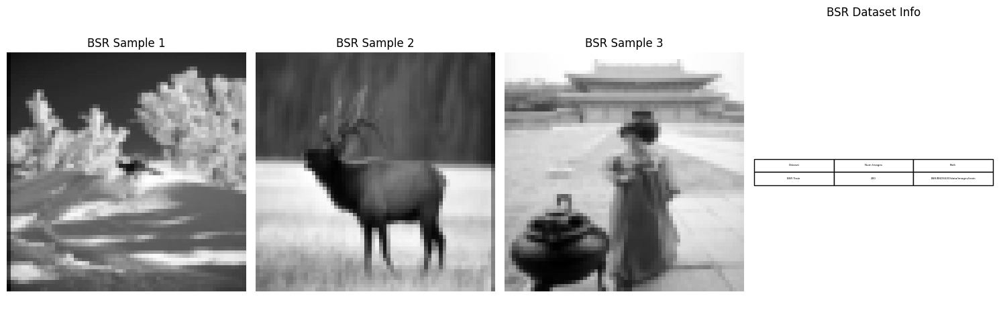

GPU Memory Allocated: 0.00 MB
GPU Memory Cached: 0.00 MB


TypeError: Unet.__init__() got an unexpected keyword argument 'checkpoint'

In [2]:

# Step 6: Prepare Images for Diffusion Model
import glob
import torch

# Download and extract BSR dataset
try:
    if not os.path.exists('BSR_bsds500.tgz'):
        !wget https://www2.eecs.berkeley.edu/Research/Projects/CS/vision/grouping/BSR/BSR_bsds500.tgz
    if not os.path.exists('BSR'):
        !tar xzf BSR_bsds500.tgz
    print("BSR Dataset loaded successfully")
except Exception as e:
    print(f"Error loading dataset: {e}")
    import sys
    sys.exit(1)

# Custom dataset class
class BSRDataset(Dataset):
    def __init__(self, root_dir, transform=None):
        self.image_paths = glob.glob(os.path.join(root_dir, '*.jpg'))
        self.transform = transform
    def __len__(self):
        return len(self.image_paths)
    def __getitem__(self, idx):
        img_path = self.image_paths[idx]
        image = Image.open(img_path).convert('L')  # Grayscale
        if self.transform:
            image = self.transform(image)
        return image

# Define transforms (64x64)
transform = transforms.Compose([
    transforms.Resize((64, 64)),
    transforms.ToTensor()
])

# Load BSR dataset (train folder)
bsr_train_path = 'BSR/BSDS500/data/images/train'
train_dataset = BSRDataset(bsr_train_path, transform=transform)
train_dataloader = DataLoader(train_dataset, batch_size=8, shuffle=True)

# Save transformed images to bsr_images for diffusion
os.makedirs("bsr_images", exist_ok=True)
for i, img in enumerate(train_dataset):
    img_np = img.squeeze().numpy() * 255.0
    Image.fromarray(img_np.astype(np.uint8)).save(f"bsr_images/train_{i}.png")

# Output: Table of dataset info
num_images = len(train_dataset)
df = pd.DataFrame([
    ['BSR Train', num_images, bsr_train_path]
], columns=['Dataset', 'Num Images', 'Path'])
print("\nBSR Dataset Info:")
print(df)

# Visualize sample BSR images and table
sample_images = [train_dataset[i] for i in range(min(3, num_images))]
plt.figure(figsize=(15, 5))
for i in range(len(sample_images)):
    plt.subplot(1, 4, i + 1)
    plt.imshow(sample_images[i].squeeze(), cmap='gray')
    plt.title(f"BSR Sample {i+1}")
    plt.axis('off')
plt.subplot(1, 4, 4)
plt.table(cellText=df.values, colLabels=df.columns, loc='center', cellLoc='center')
plt.axis('off')
plt.title("BSR Dataset Info")
plt.tight_layout()
plt.savefig("comparisons/step6_bsr_info.png")
plt.show()

# Step 7: Train Diffusion Model
# Clear GPU memory
torch.cuda.empty_cache()
print(f"GPU Memory Allocated: {torch.cuda.memory_allocated() / 1024**2:.2f} MB")
print(f"GPU Memory Cached: {torch.cuda.memory_reserved() / 1024**2:.2f} MB")

model = Unet(
    dim=96,  # Reduced from 128
    dim_mults=(1, 2, 4, 8),
    flash_attn=True,
    channels=1,  # Grayscale
    checkpoint=True  # Enable gradient checkpointing
)

diffusion = GaussianDiffusion(
    model,
    image_size=64,
    timesteps=1000,
    sampling_timesteps=100  # Reduced from 200
)

trainer = Trainer(
    diffusion,
    'bsr_images',
    train_batch_size=8,  # Reduced from 16
    train_lr=8e-5,
    train_num_steps=500,  # Reduced from 1000
    gradient_accumulate_every=2,
    ema_decay=0.995,
    amp=True,
    calculate_fid=False,
    save_and_sample_every=100  # Save checkpoints
)

print("Starting diffusion model training...")
trainer.train()
print("Diffusion model training completed.")

# Output: Function for diffusion model summary
def diffusion_summary():
    return pd.DataFrame([
        ['U-Net', 'dim=96, mults=(1,2,4,8), channels=1'],
        ['Diffusion', 'image_size=64, timesteps=1000, sampling=100'],
        ['Trainer', 'batch_size=8, steps=500']
    ], columns=['Component', 'Config'])

df = diffusion_summary()
print("\nDiffusion Model Summary:")
print(df)

plt.figure(figsize=(8, 3))
plt.table(cellText=df.values, colLabels=df.columns, loc='center', cellLoc='center')
plt.axis('off')
plt.title("Diffusion Model Summary")
plt.savefig("comparisons/step7_diffusion_summary.png")
plt.show()

# Step 8: Hybrid Inference and Visualization
# Preprocess function for diffusion model (64x64)
def preprocess_for_diffusion(image, size=64):
    img = Image.fromarray((image * 255).astype(np.uint8)).convert('L')
    img = img.resize((size, size), Image.LANCZOS)
    img = np.array(img).astype(np.float32) / 255.0
    img = torch.from_numpy(img).unsqueeze(0).unsqueeze(0).to(device)
    print(f"Preprocessed tensor shape: {img.shape}, device: {img.device}")
    return img

# Hybrid inference and visualization
results = {}
diffusion.model.to(device)  # Ensure model is on GPU
diffusion.model.eval()     # Set to evaluation mode
torch.cuda.empty_cache()   # Clear GPU memory before inference
print(f"GPU Memory Allocated: {torch.cuda.memory_allocated() / 1024**2:.2f} MB")
print(f"GPU Memory Cached: {torch.cuda.memory_reserved() / 1024**2:.2f} MB")

for name in images:
    results[name] = {}
    for sigma in sigma_noise_levels:
        noisy_img = noisy_images[name][sigma]
        pde_img = pde_denoised_images[name][sigma]
        clean_img = images[name]
        # Diffusion inference
        pde_img_resized = preprocess_for_diffusion(pde_img)
        print(f"Inferring hybrid output for {name}, σ={sigma}")
        with torch.no_grad():
            hybrid_img = diffusion.p_sample_loop(pde_img_resized, timesteps=diffusion.sampling_timesteps)
        hybrid_img = hybrid_img.squeeze().cpu().numpy()
        print(f"Hybrid output shape: {hybrid_img.shape}")
        # Resize back to original size
        hybrid_img_pil = Image.fromarray((hybrid_img * 255).astype(np.uint8))
        hybrid_img_pil = hybrid_img_pil.resize((clean_img.shape[1], clean_img.shape[0]), Image.LANCZOS)
        hybrid_img = np.array(hybrid_img_pil).astype(np.float32) / 255.0
        # Metrics
        results[name][sigma] = {
            "Noisy": {
                "PSNR": peak_signal_noise_ratio(clean_img, noisy_img, data_range=1.0),
                "SSIM": structural_similarity(clean_img, noisy_img, data_range=1.0)
            },
            "PDE": {
                "PSNR": peak_signal_noise_ratio(clean_img, pde_img, data_range=1.0),
                "SSIM": structural_similarity(clean_img, pde_img, data_range=1.0)
            },
            "Hybrid": {
                "PSNR": peak_signal_noise_ratio(clean_img, hybrid_img, data_range=1.0),
                "SSIM": structural_similarity(clean_img, hybrid_img, data_range=1.0)
            }
        }
        # Visualize
        plt.figure(figsize=(20, 5))
        plt.subplot(1, 4, 1)
        plt.imshow(clean_img, cmap='gray')
        plt.title(f"{name} Original")
        plt.axis('off')
        plt.subplot(1, 4, 2)
        plt.imshow(noisy_img, cmap='gray')
        plt.title(f"{name} Noisy (σ={sigma})")
        plt.axis('off')
        plt.subplot(1, 4, 3)
        plt.imshow(pde_img, cmap='gray')
        plt.title(f"{name} PDE-Denoised")
        plt.axis('off')
        plt.subplot(1, 4, 4)
        plt.imshow(hybrid_img, cmap='gray')
        plt.title(f"{name} Hybrid-Denoised")
        plt.axis('off')
        plt.tight_layout()
        plt.savefig(f"comparisons/comparison_{name}_sigma_{sigma}.png")
        plt.show()

# Output: Table of final metrics
metrics = []
for name in results:
    for sigma in results[name]:
        for method in results[name][sigma]:
            metrics.append([name, sigma, method, results[name][sigma][method]['PSNR'], results[name][sigma][method]['SSIM']])
df = pd.DataFrame(metrics, columns=['Image', 'Sigma', 'Method', 'PSNR', 'SSIM'])
print("\nFinal Denoising Metrics:")
print(df)

plt.figure(figsize=(10, 8))
plt.table(cellText=df.values, colLabels=df.columns, loc='center', cellLoc='center')
plt.axis('off')
plt.title("Final Denoising Metrics")
plt.savefig("comparisons/step8_final_metrics.png")
plt.show()


Using device: cuda

Installed Packages:
                       Package       Version
0                        numpy         2.0.2
1                opencv-python     4.11.0.86
2                 scikit-image        0.25.2
3                   matplotlib        3.10.0
4                        torch   2.6.0+cu124
5                  torchvision  0.21.0+cu124
6  denoising-diffusion-pytorch         2.1.1


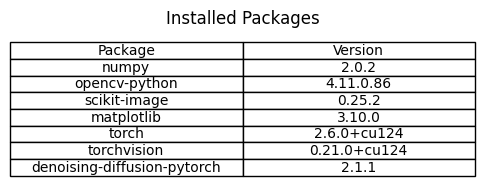

Please upload Barbara.jpg and bee_2.jpg


Saving bee_2.jpg to bee_2 (3).jpg
Saving Barbara.jpg to Barbara (3).jpg

Loaded Images:
     Image       Shape
0  Barbara  (512, 512)
1      Bee  (443, 590)


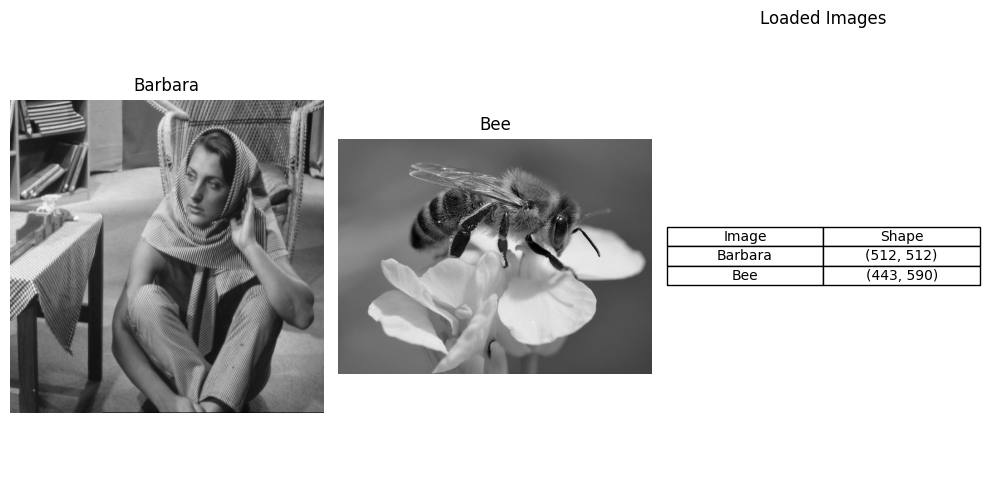


Noisy Image Metrics:
     Image  Sigma       PSNR      SSIM
0  Barbara     10  28.131132  0.701626
1  Barbara     20  22.151408  0.458164
2  Barbara     30  18.715393  0.321705
3  Barbara     40  16.378924  0.238165
4      Bee     10  28.131941  0.534666
5      Bee     20  22.182748  0.291283
6      Bee     30  18.773405  0.192429
7      Bee     40  16.409236  0.139546


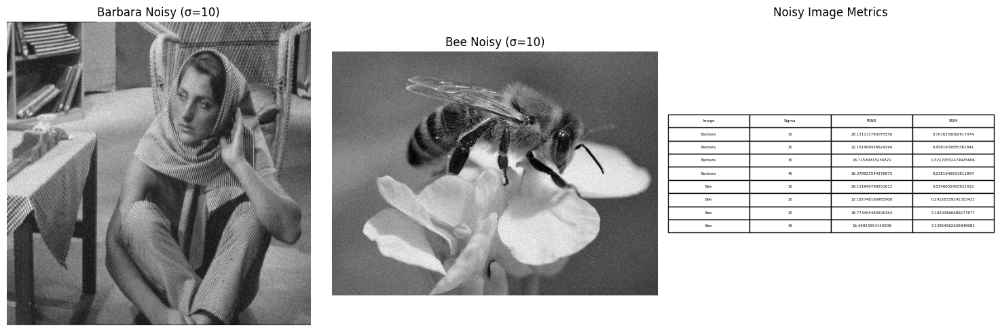

PDE Functions Defined: p, q, compute_gradient, double_phase_operator, solve_pde

PDE Function Descriptions:
                Function                      Description
0                      p  Computes variable exponent p(x)
1                      q  Computes variable exponent q(x)
2       compute_gradient       Calculates image gradients
3  double_phase_operator     Computes PDE flux divergence
4              solve_pde         Solves PDE for denoising


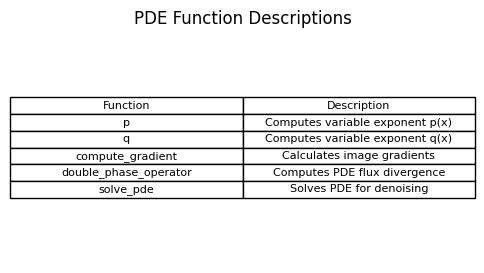

Processing Barbara, σ=10
Processing Barbara, σ=20
Processing Barbara, σ=30
Processing Barbara, σ=40
Processing Bee, σ=10
Processing Bee, σ=20
Processing Bee, σ=30
Processing Bee, σ=40

PDE Denoised Metrics:
     Image  Sigma       PSNR      SSIM
0  Barbara     10  12.712602  0.218498
1  Barbara     20  11.768864  0.170121
2  Barbara     30  10.959861  0.135542
3  Barbara     40  10.295711  0.110428
4      Bee     10  12.399460  0.108238
5      Bee     20  11.587839  0.086903
6      Bee     30  10.862509  0.071778
7      Bee     40  10.225004  0.059713


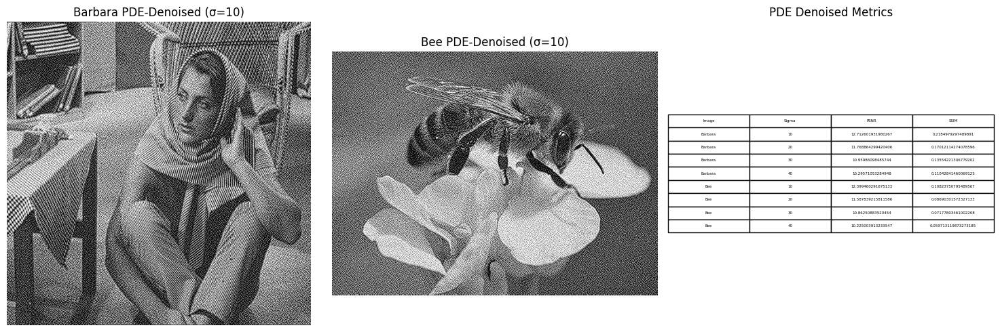

BSR Dataset loaded successfully

BSR Dataset Info:
     Dataset  Num Images                           Path
0  BSR Train         200  BSR/BSDS500/data/images/train


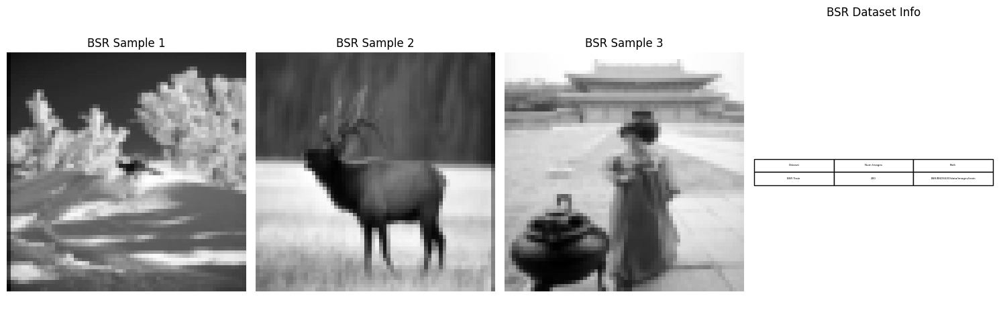

In [4]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from skimage.metrics import peak_signal_noise_ratio, structural_similarity, mean_squared_error
import os
import torch
from PIL import Image
from torch.utils.data import Dataset, DataLoader
import torchvision.transforms as transforms
import pandas as pd
from denoising_diffusion_pytorch import Unet, GaussianDiffusion, Trainer
import glob

# Enable inline plotting
%matplotlib inline

# Create output directories
os.makedirs("denoise_steps", exist_ok=True)
os.makedirs("comparisons", exist_ok=True)
os.makedirs("bsr_images", exist_ok=True)

# Verify GPU
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")

# Output: Table of installed packages
import pkg_resources
packages = ['numpy', 'opencv-python', 'scikit-image', 'matplotlib', 'torch', 'torchvision', 'denoising-diffusion-pytorch']
installed = {pkg: pkg_resources.get_distribution(pkg).version for pkg in packages}
df = pd.DataFrame(list(installed.items()), columns=['Package', 'Version'])
print("\nInstalled Packages:")
print(df)

# Plot table
plt.figure(figsize=(6, 2))
plt.table(cellText=df.values, colLabels=df.columns, loc='center', cellLoc='center')
plt.axis('off')
plt.title("Installed Packages")
plt.savefig("comparisons/step1_packages.png")
plt.show()

# Step 2: Upload and Load Images
from google.colab import files

# Upload Barbara and Bee images
print("Please upload Barbara.jpg and bee_2.jpg")
uploaded = files.upload()

# Define image paths
image_paths = {
    "Barbara": "/content/Barbara.jpg",
    "Bee": "/content/bee_2.jpg",
}

# Load images
images = {}
for name, path in image_paths.items():
    img = cv2.imread(path, cv2.IMREAD_GRAYSCALE)
    if img is None:
        print(f"Error: Failed to load {name} from {path}")
    else:
        images[name] = img

# Exit if no images loaded
if not images:
    print("Error: No images loaded. Exiting.")
    import sys
    sys.exit(1)

# Output: Table of loaded images
df = pd.DataFrame([(name, img.shape) for name, img in images.items()], columns=['Image', 'Shape'])
print("\nLoaded Images:")
print(df)

# Visualize loaded images and table
plt.figure(figsize=(10, 5))
for i, (name, img) in enumerate(images.items(), 1):
    plt.subplot(1, len(images) + 1, i)
    plt.imshow(img, cmap='gray')
    plt.title(name)
    plt.axis('off')
plt.subplot(1, len(images) + 1, len(images) + 1)
plt.table(cellText=df.values, colLabels=df.columns, loc='center', cellLoc='center')
plt.axis('off')
plt.title("Loaded Images")
plt.tight_layout()
plt.savefig("comparisons/step2_images.png")
plt.show()

# Step 3: Normalize Images and Add Noise
sigma_noise_levels = [10, 20, 30, 40]
noisy_images = {}

# Normalize and add noise
for name in images:
    images[name] = images[name].astype(float) / 255.0
    noisy_images[name] = {}
    for sigma in sigma_noise_levels:
        scaled_sigma = sigma / 255.0
        noise = np.random.normal(0, scaled_sigma, images[name].shape)
        noisy_images[name][sigma] = np.clip(images[name] + noise, 0, 1)
        cv2.imwrite(f"noisy_{name}_sigma_{sigma}.png", (noisy_images[name][sigma] * 255).astype(np.uint8))

# Output: Table of noisy image metrics
metrics = []
for name in images:
    for sigma in sigma_noise_levels:
        psnr_val = peak_signal_noise_ratio(images[name], noisy_images[name][sigma], data_range=1.0)
        ssim_val = structural_similarity(images[name], noisy_images[name][sigma], data_range=1.0)
        metrics.append([name, sigma, psnr_val, ssim_val])
df = pd.DataFrame(metrics, columns=['Image', 'Sigma', 'PSNR', 'SSIM'])
print("\nNoisy Image Metrics:")
print(df)

# Visualize noisy images and table (example for σ=10)
plt.figure(figsize=(15, 5))
for i, name in enumerate(images, 1):
    plt.subplot(1, len(images) + 1, i)
    plt.imshow(noisy_images[name][10], cmap='gray')
    plt.title(f"{name} Noisy (σ=10)")
    plt.axis('off')
plt.subplot(1, len(images) + 1, len(images) + 1)
plt.table(cellText=df.values, colLabels=df.columns, loc='center', cellLoc='center')
plt.axis('off')
plt.title("Noisy Image Metrics")
plt.tight_layout()
plt.savefig("comparisons/step3_noisy_metrics.png")
plt.show()

# Step 4: Define PDE Denoising Functions
def p(x, k1):
    return 1 + 1 / (1 + k1 * np.linalg.norm(x)**2)

def q(x, k2):
    return 1 + 1 / (1 + k2 * np.linalg.norm(x)**2)

def compute_gradient(u):
    grad_x = np.gradient(u, axis=1)
    grad_y = np.gradient(u, axis=0)
    return grad_x, grad_y

def double_phase_operator(u, X, Y, k1, k2):
    grad_x, grad_y = compute_gradient(u)
    grad_norm = np.sqrt(grad_x**2 + grad_y**2 + 1e-4)
    p_vals = p(np.stack([X, Y], axis=-1), k1)
    q_vals = q(np.stack([X, Y], axis=-1), k2)
    flux_x = (grad_norm**(p_vals-2) + grad_norm**(q_vals-2)) * grad_x
    flux_y = (grad_norm**(p_vals-2) + grad_norm**(q_vals-2)) * grad_y
    div_x = np.gradient(flux_x, axis=1)
    div_y = np.gradient(flux_y, axis=0)
    return div_x + div_y

def solve_pde(noisy_image, k1=1.0, k2=1.0, T=0.1, dt=0.00005, h=1.0, image_name="", sigma=0):
    u = noisy_image.copy()
    height, width = u.shape
    x = np.arange(0, width, h)
    y = np.arange(0, height, h)
    X, Y = np.meshgrid(x, y)
    num_iterations = int(T / dt)
    prev_u = u.copy()

    for t in range(num_iterations):
        diffusion_term = double_phase_operator(u, X, Y, k1, k2)
        u -= dt * diffusion_term
        u = np.clip(u, 0, 1)
        if np.any(np.isnan(u)) or np.any(np.isinf(u)):
            print(f"Warning: Invalid values at iteration {t} for {image_name}, σ={sigma}")
            return u
        if t % 100 == 0 and t > 0:
            diff = np.mean(np.abs(u - prev_u))
            if diff < 1e-4:
                print(f"Early stopping at iteration {t} for {image_name}, σ={sigma}")
                break
            prev_u = u.copy()
        if t % 500 == 0:
            plt.figure(figsize=(5, 5))
            plt.imshow(u, cmap='gray')
            plt.title(f"{image_name}, σ={sigma}, Iteration {t}")
            plt.axis('off')
            plt.savefig(f"denoise_steps/denoise_{image_name}_sigma_{sigma}_iter_{t}.png")
            plt.close()

    cv2.imwrite(f"denoise_{image_name}_sigma_{sigma}_pde.png", (u * 255).astype(np.uint8))
    return u

# Output: Function definitions
print("PDE Functions Defined: p, q, compute_gradient, double_phase_operator, solve_pde")

# Visualize function descriptions (table)
df = pd.DataFrame([
    ['p', 'Computes variable exponent p(x)'],
    ['q', 'Computes variable exponent q(x)'],
    ['compute_gradient', 'Calculates image gradients'],
    ['double_phase_operator', 'Computes PDE flux divergence'],
    ['solve_pde', 'Solves PDE for denoising']
], columns=['Function', 'Description'])
print("\nPDE Function Descriptions:")
print(df)

plt.figure(figsize=(6, 3))
plt.table(cellText=df.values, colLabels=df.columns, loc='center', cellLoc='center')
plt.axis('off')
plt.title("PDE Function Descriptions")
plt.savefig("comparisons/step4_functions.png")
plt.show()

# Step 5: Apply PDE Denoising
pde_denoised_images = {}
for name in images:
    pde_denoised_images[name] = {}
    for sigma in sigma_noise_levels:
        print(f"Processing {name}, σ={sigma}")
        pde_denoised_images[name][sigma] = solve_pde(
            noisy_images[name][sigma], k1=1.0, k2=1.0, T=0.1, dt=0.00005,
            image_name=name, sigma=sigma
        )

# Output: Table of PDE denoising metrics
metrics = []
for name in images:
    for sigma in sigma_noise_levels:
        psnr_val = peak_signal_noise_ratio(images[name], pde_denoised_images[name][sigma], data_range=1.0)
        ssim_val = structural_similarity(images[name], pde_denoised_images[name][sigma], data_range=1.0)
        metrics.append([name, sigma, psnr_val, ssim_val])
df = pd.DataFrame(metrics, columns=['Image', 'Sigma', 'PSNR', 'SSIM'])
print("\nPDE Denoised Metrics:")
print(df)

# Visualize PDE-denoised images (σ=10) and table
plt.figure(figsize=(15, 5))
for i, name in enumerate(images, 1):
    plt.subplot(1, len(images) + 1, i)
    plt.imshow(pde_denoised_images[name][10], cmap='gray')
    plt.title(f"{name} PDE-Denoised (σ=10)")
    plt.axis('off')
plt.subplot(1, len(images) + 1, len(images) + 1)
plt.table(cellText=df.values, colLabels=df.columns, loc='center', cellLoc='center')
plt.axis('off')
plt.title("PDE Denoised Metrics")
plt.tight_layout()
plt.savefig("comparisons/step5_pde_metrics.png")
plt.show()

# Step 6: Prepare Images for Diffusion Model
# Download and extract BSR dataset
try:
    if not os.path.exists('BSR_bsds500.tgz'):
        !wget https://www2.eecs.berkeley.edu/Research/Projects/CS/vision/grouping/BSR/BSR_bsds500.tgz
    if not os.path.exists('BSR'):
        !tar xzf BSR_bsds500.tgz
    print("BSR Dataset loaded successfully")
except Exception as e:
    print(f"Error loading dataset: {e}")
    import sys
    sys.exit(1)

# Custom dataset class
class BSRDataset(Dataset):
    def __init__(self, root_dir, transform=None):
        self.image_paths = glob.glob(os.path.join(root_dir, '*.jpg'))
        self.transform = transform
    def __len__(self):
        return len(self.image_paths)
    def __getitem__(self, idx):
        img_path = self.image_paths[idx]
        image = Image.open(img_path).convert('L')  # Grayscale
        if self.transform:
            image = self.transform(image)
        return image

# Define transforms (64x64)
transform = transforms.Compose([
    transforms.Resize((64, 64)),
    transforms.ToTensor()
])

# Load BSR dataset (train folder)
bsr_train_path = 'BSR/BSDS500/data/images/train'
train_dataset = BSRDataset(bsr_train_path, transform=transform)
train_dataloader = DataLoader(train_dataset, batch_size=4, shuffle=True)

# Save transformed images to bsr_images for diffusion
os.makedirs("bsr_images", exist_ok=True)
for i, img in enumerate(train_dataset):
    img_np = img.squeeze().numpy() * 255.0
    Image.fromarray(img_np.astype(np.uint8)).save(f"bsr_images/train_{i}.png")

# Output: Table of dataset info
num_images = len(train_dataset)
df = pd.DataFrame([
    ['BSR Train', num_images, bsr_train_path]
], columns=['Dataset', 'Num Images', 'Path'])
print("\nBSR Dataset Info:")
print(df)

# Visualize sample BSR images and table
sample_images = [train_dataset[i] for i in range(min(3, num_images))]
plt.figure(figsize=(15, 5))
for i in range(len(sample_images)):
    plt.subplot(1, 4, i + 1)
    plt.imshow(sample_images[i].squeeze(), cmap='gray')
    plt.title(f"BSR Sample {i+1}")
    plt.axis('off')
plt.subplot(1, 4, 4)
plt.table(cellText=df.values, colLabels=df.columns, loc='center', cellLoc='center')
plt.axis('off')
plt.title("BSR Dataset Info")
plt.tight_layout()
plt.savefig("comparisons/step6_bsr_info.png")
plt.show()

Using device: cuda

Installed Packages:
                       Package       Version
0                        numpy         2.0.2
1                opencv-python     4.11.0.86
2                 scikit-image        0.25.2
3                   matplotlib        3.10.0
4                        torch   2.6.0+cu124
5                  torchvision  0.21.0+cu124
6  denoising-diffusion-pytorch         2.1.1


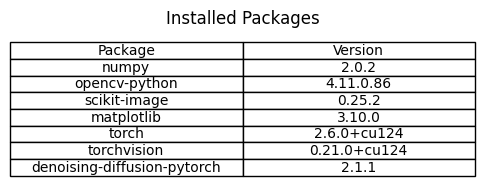

Please upload Barbara.jpg and bee_2.jpg


Saving bee_2.jpg to bee_2 (4).jpg
Saving Barbara.jpg to Barbara (4).jpg

Loaded Images:
     Image       Shape
0  Barbara  (512, 512)
1      Bee  (443, 590)


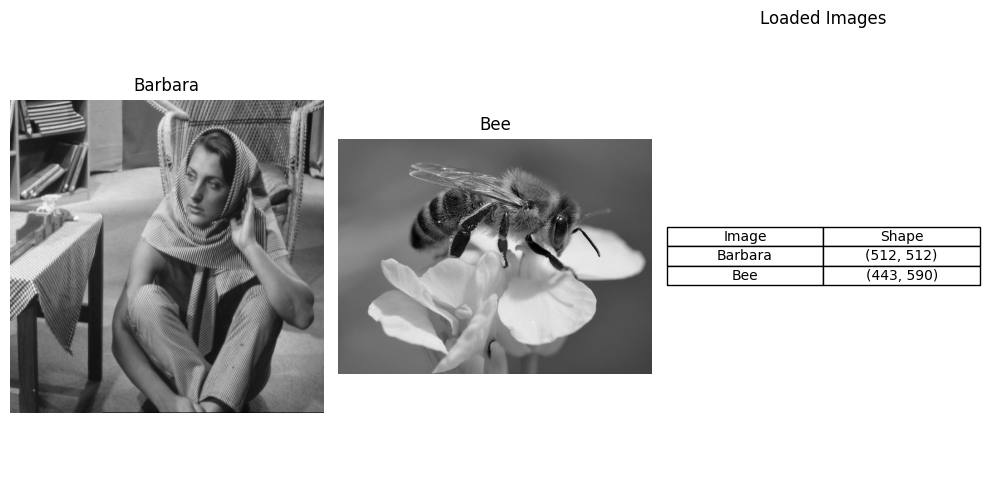


Noisy Image Metrics:
     Image  Sigma       PSNR      SSIM
0  Barbara     10  28.108098  0.701896
1  Barbara     20  22.120457  0.457682
2  Barbara     30  18.722881  0.322012
3  Barbara     40  16.368318  0.237250
4      Bee     10  28.161280  0.536405
5      Bee     20  22.199503  0.292764
6      Bee     30  18.748387  0.192340
7      Bee     40  16.408417  0.140104


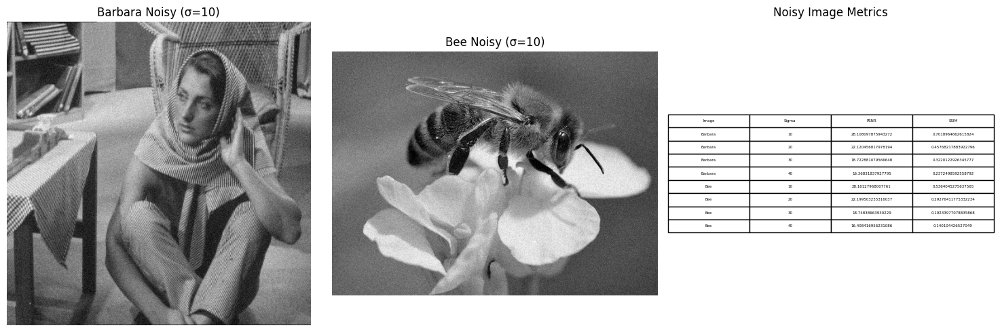

PDE Functions Defined: p, q, compute_gradient, double_phase_operator, solve_pde

PDE Function Descriptions:
                Function                      Description
0                      p  Computes variable exponent p(x)
1                      q  Computes variable exponent q(x)
2       compute_gradient       Calculates image gradients
3  double_phase_operator     Computes PDE flux divergence
4              solve_pde         Solves PDE for denoising


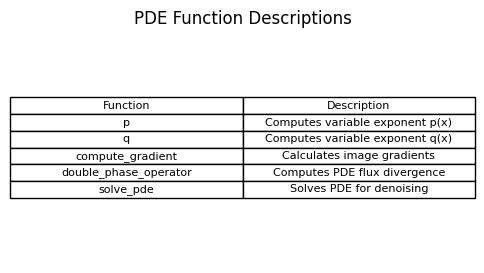

Processing Barbara, σ=10
Processing Barbara, σ=20
Processing Barbara, σ=30
Processing Barbara, σ=40
Processing Bee, σ=10
Processing Bee, σ=20
Processing Bee, σ=30
Processing Bee, σ=40

PDE Denoised Metrics:
     Image  Sigma       PSNR      SSIM
0  Barbara     10  12.706159  0.218575
1  Barbara     20  11.752131  0.169710
2  Barbara     30  10.955503  0.134862
3  Barbara     40  10.296544  0.110092
4      Bee     10  12.388522  0.108199
5      Bee     20  11.599835  0.087500
6      Bee     30  10.849880  0.071498
7      Bee     40  10.228053  0.060035


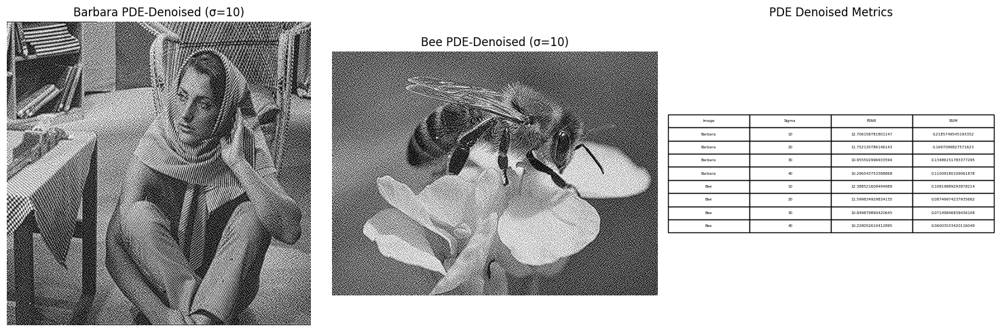

BSR Dataset loaded successfully

BSR Dataset Info:
     Dataset  Num Images                           Path
0  BSR Train         200  BSR/BSDS500/data/images/train


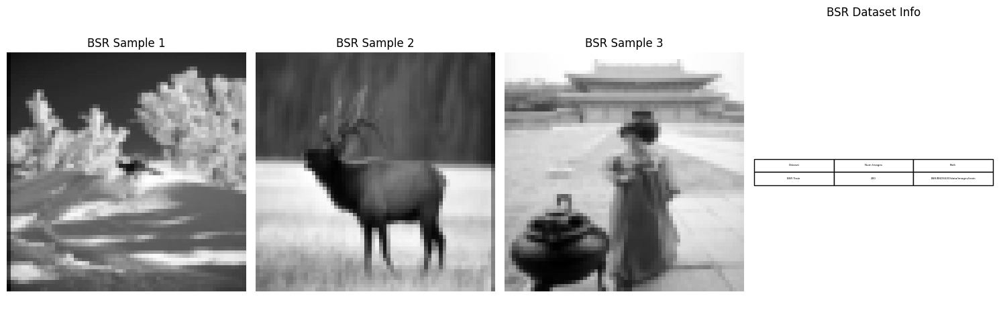

GPU Memory Allocated: 0.00 MB
GPU Memory Cached: 0.00 MB
Starting diffusion model training...


  0%|          | 0/500 [00:00<?, ?it/s]

/usr/lib/python3.11/contextlib.py:105: FutureWarning: `torch.backends.cuda.sdp_kernel()` is deprecated. In the future, this context manager will be removed. Please see `torch.nn.attention.sdpa_kernel()` for the new context manager, with updated signature.
  self.gen = func(*args, **kwds)


sampling loop time step:   0%|          | 0/100 [00:00<?, ?it/s]

sampling loop time step:   0%|          | 0/100 [00:00<?, ?it/s]

sampling loop time step:   0%|          | 0/100 [00:00<?, ?it/s]

sampling loop time step:   0%|          | 0/100 [00:00<?, ?it/s]

sampling loop time step:   0%|          | 0/100 [00:00<?, ?it/s]

sampling loop time step:   0%|          | 0/100 [00:00<?, ?it/s]

sampling loop time step:   0%|          | 0/100 [00:00<?, ?it/s]

sampling loop time step:   0%|          | 0/100 [00:00<?, ?it/s]

sampling loop time step:   0%|          | 0/100 [00:00<?, ?it/s]

sampling loop time step:   0%|          | 0/100 [00:00<?, ?it/s]

sampling loop time step:   0%|          | 0/100 [00:00<?, ?it/s]

sampling loop time step:   0%|          | 0/100 [00:00<?, ?it/s]

sampling loop time step:   0%|          | 0/100 [00:00<?, ?it/s]

sampling loop time step:   0%|          | 0/100 [00:00<?, ?it/s]

sampling loop time step:   0%|          | 0/100 [00:00<?, ?it/s]

sampling loop time step:   0%|          | 0/100 [00:00<?, ?it/s]

sampling loop time step:   0%|          | 0/100 [00:00<?, ?it/s]

sampling loop time step:   0%|          | 0/100 [00:00<?, ?it/s]

sampling loop time step:   0%|          | 0/100 [00:00<?, ?it/s]

sampling loop time step:   0%|          | 0/100 [00:00<?, ?it/s]

training complete
Diffusion model training completed.

Diffusion Model Summary:
   Component                                       Config
0      U-Net          dim=64, mults=(1,2,4,8), channels=1
1  Diffusion  image_size=64, timesteps=1000, sampling=100
2    Trainer                      batch_size=8, steps=500


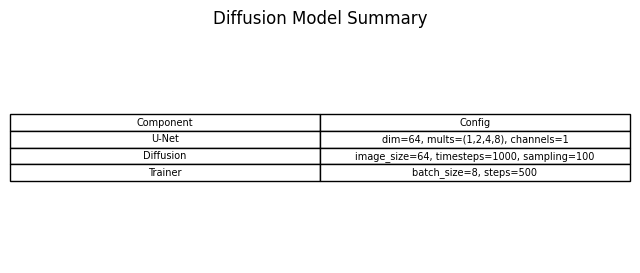

GPU Memory Allocated: 573.34 MB
GPU Memory Cached: 688.00 MB
Preprocessed tensor shape: torch.Size([1, 1, 64, 64]), device: cuda:0
Inferring hybrid output for Barbara, σ=10


TypeError: GaussianDiffusion.p_sample_loop() got an unexpected keyword argument 'timesteps'

In [6]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from skimage.metrics import peak_signal_noise_ratio, structural_similarity, mean_squared_error
import os
import torch
from PIL import Image
from torch.utils.data import Dataset, DataLoader
import torchvision.transforms as transforms
import pandas as pd
from denoising_diffusion_pytorch import Unet, GaussianDiffusion, Trainer
import glob
import sys

# Enable inline plotting
%matplotlib inline

# Create output directories
os.makedirs("denoise_steps", exist_ok=True)
os.makedirs("comparisons", exist_ok=True)
os.makedirs("bsr_images", exist_ok=True)

# Verify GPU
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")

# Output: Table of installed packages
import pkg_resources
packages = ['numpy', 'opencv-python', 'scikit-image', 'matplotlib', 'torch', 'torchvision', 'denoising-diffusion-pytorch']
installed = {pkg: pkg_resources.get_distribution(pkg).version for pkg in packages}
df = pd.DataFrame(list(installed.items()), columns=['Package', 'Version'])
print("\nInstalled Packages:")
print(df)

# Plot table
plt.figure(figsize=(6, 2))
plt.table(cellText=df.values, colLabels=df.columns, loc='center', cellLoc='center')
plt.axis('off')
plt.title("Installed Packages")
plt.savefig("comparisons/step1_packages.png")
plt.show()

# Step 2: Upload and Load Images
from google.colab import files

# Upload Barbara and Bee images
print("Please upload Barbara.jpg and bee_2.jpg")
uploaded = files.upload()

# Define image paths
image_paths = {
    "Barbara": "/content/Barbara.jpg",
    "Bee": "/content/bee_2.jpg",
}

# Load images
images = {}
for name, path in image_paths.items():
    img = cv2.imread(path, cv2.IMREAD_GRAYSCALE)
    if img is None:
        print(f"Error: Failed to load {name} from {path}")
    else:
        images[name] = img

# Exit if no images loaded
if not images:
    print("Error: No images loaded. Exiting.")
    sys.exit(1)

# Output: Table of loaded images
df = pd.DataFrame([(name, img.shape) for name, img in images.items()], columns=['Image', 'Shape'])
print("\nLoaded Images:")
print(df)

# Visualize loaded images and table
plt.figure(figsize=(10, 5))
for i, (name, img) in enumerate(images.items(), 1):
    plt.subplot(1, len(images) + 1, i)
    plt.imshow(img, cmap='gray')
    plt.title(name)
    plt.axis('off')
plt.subplot(1, len(images) + 1, len(images) + 1)
plt.table(cellText=df.values, colLabels=df.columns, loc='center', cellLoc='center')
plt.axis('off')
plt.title("Loaded Images")
plt.tight_layout()
plt.savefig("comparisons/step2_images.png")
plt.show()

# Step 3: Normalize Images and Add Noise
sigma_noise_levels = [10, 20, 30, 40]
noisy_images = {}

# Normalize and add noise
for name in images:
    images[name] = images[name].astype(float) / 255.0
    noisy_images[name] = {}
    for sigma in sigma_noise_levels:
        scaled_sigma = sigma / 255.0
        noise = np.random.normal(0, scaled_sigma, images[name].shape)
        noisy_images[name][sigma] = np.clip(images[name] + noise, 0, 1)
        cv2.imwrite(f"noisy_{name}_sigma_{sigma}.png", (noisy_images[name][sigma] * 255).astype(np.uint8))

# Output: Table of noisy image metrics
metrics = []
for name in images:
    for sigma in sigma_noise_levels:
        psnr_val = peak_signal_noise_ratio(images[name], noisy_images[name][sigma], data_range=1.0)
        ssim_val = structural_similarity(images[name], noisy_images[name][sigma], data_range=1.0)
        metrics.append([name, sigma, psnr_val, ssim_val])
df = pd.DataFrame(metrics, columns=['Image', 'Sigma', 'PSNR', 'SSIM'])
print("\nNoisy Image Metrics:")
print(df)

# Visualize noisy images and table (example for σ=10)
plt.figure(figsize=(15, 5))
for i, name in enumerate(images, 1):
    plt.subplot(1, len(images) + 1, i)
    plt.imshow(noisy_images[name][10], cmap='gray')
    plt.title(f"{name} Noisy (σ=10)")
    plt.axis('off')
plt.subplot(1, len(images) + 1, len(images) + 1)
plt.table(cellText=df.values, colLabels=df.columns, loc='center', cellLoc='center')
plt.axis('off')
plt.title("Noisy Image Metrics")
plt.tight_layout()
plt.savefig("comparisons/step3_noisy_metrics.png")
plt.show()

# Step 4: Define PDE Denoising Functions
def p(x, k1):
    return 1 + 1 / (1 + k1 * np.linalg.norm(x)**2)

def q(x, k2):
    return 1 + 1 / (1 + k2 * np.linalg.norm(x)**2)

def compute_gradient(u):
    grad_x = np.gradient(u, axis=1)
    grad_y = np.gradient(u, axis=0)
    return grad_x, grad_y

def double_phase_operator(u, X, Y, k1, k2):
    grad_x, grad_y = compute_gradient(u)
    grad_norm = np.sqrt(grad_x**2 + grad_y**2 + 1e-4)
    p_vals = p(np.stack([X, Y], axis=-1), k1)
    q_vals = q(np.stack([X, Y], axis=-1), k2)
    flux_x = (grad_norm**(p_vals-2) + grad_norm**(q_vals-2)) * grad_x
    flux_y = (grad_norm**(p_vals-2) + grad_norm**(q_vals-2)) * grad_y
    div_x = np.gradient(flux_x, axis=1)
    div_y = np.gradient(flux_y, axis=0)
    return div_x + div_y

def solve_pde(noisy_image, k1=1.0, k2=1.0, T=0.1, dt=0.00005, h=1.0, image_name="", sigma=0):
    u = noisy_image.copy()
    height, width = u.shape
    x = np.arange(0, width, h)
    y = np.arange(0, height, h)
    X, Y = np.meshgrid(x, y)
    num_iterations = int(T / dt)
    prev_u = u.copy()

    for t in range(num_iterations):
        diffusion_term = double_phase_operator(u, X, Y, k1, k2)
        u -= dt * diffusion_term
        u = np.clip(u, 0, 1)
        if np.any(np.isnan(u)) or np.any(np.isinf(u)):
            print(f"Warning: Invalid values at iteration {t} for {image_name}, σ={sigma}")
            return u
        if t % 100 == 0 and t > 0:
            diff = np.mean(np.abs(u - prev_u))
            if diff < 1e-4:
                print(f"Early stopping at iteration {t} for {image_name}, σ={sigma}")
                break
            prev_u = u.copy()
        if t % 500 == 0:
            plt.figure(figsize=(5, 5))
            plt.imshow(u, cmap='gray')
            plt.title(f"{image_name}, σ={sigma}, Iteration {t}")
            plt.axis('off')
            plt.savefig(f"denoise_steps/denoise_{image_name}_sigma_{sigma}_iter_{t}.png")
            plt.close()

    cv2.imwrite(f"denoise_{image_name}_sigma_{sigma}_pde.png", (u * 255).astype(np.uint8))
    return u

# Output: Function definitions
print("PDE Functions Defined: p, q, compute_gradient, double_phase_operator, solve_pde")

# Visualize function descriptions (table)
df = pd.DataFrame([
    ['p', 'Computes variable exponent p(x)'],
    ['q', 'Computes variable exponent q(x)'],
    ['compute_gradient', 'Calculates image gradients'],
    ['double_phase_operator', 'Computes PDE flux divergence'],
    ['solve_pde', 'Solves PDE for denoising']
], columns=['Function', 'Description'])
print("\nPDE Function Descriptions:")
print(df)

plt.figure(figsize=(6, 3))
plt.table(cellText=df.values, colLabels=df.columns, loc='center', cellLoc='center')
plt.axis('off')
plt.title("PDE Function Descriptions")
plt.savefig("comparisons/step4_functions.png")
plt.show()

# Step 5: Apply PDE Denoising
pde_denoised_images = {}
for name in images:
    pde_denoised_images[name] = {}
    for sigma in sigma_noise_levels:
        print(f"Processing {name}, σ={sigma}")
        pde_denoised_images[name][sigma] = solve_pde(
            noisy_images[name][sigma], k1=1.0, k2=1.0, T=0.1, dt=0.00005,
            image_name=name, sigma=sigma
        )

# Output: Table of PDE denoising metrics
metrics = []
for name in images:
    for sigma in sigma_noise_levels:
        psnr_val = peak_signal_noise_ratio(images[name], pde_denoised_images[name][sigma], data_range=1.0)
        ssim_val = structural_similarity(images[name], pde_denoised_images[name][sigma], data_range=1.0)
        metrics.append([name, sigma, psnr_val, ssim_val])
df = pd.DataFrame(metrics, columns=['Image', 'Sigma', 'PSNR', 'SSIM'])
print("\nPDE Denoised Metrics:")
print(df)

# Visualize PDE-denoised images (σ=10) and table
plt.figure(figsize=(15, 5))
for i, name in enumerate(images, 1):
    plt.subplot(1, len(images) + 1, i)
    plt.imshow(pde_denoised_images[name][10], cmap='gray')
    plt.title(f"{name} PDE-Denoised (σ=10)")
    plt.axis('off')
plt.subplot(1, len(images) + 1, len(images) + 1)
plt.table(cellText=df.values, colLabels=df.columns, loc='center', cellLoc='center')
plt.axis('off')
plt.title("PDE Denoised Metrics")
plt.tight_layout()
plt.savefig("comparisons/step5_pde_metrics.png")
plt.show()

# Step 6: Prepare Images for Diffusion Model
# Download and extract BSR dataset
try:
    if not os.path.exists('BSR_bsds500.tgz'):
        !wget https://www2.eecs.berkeley.edu/Research/Projects/CS/vision/grouping/BSR/BSR_bsds500.tgz
    if not os.path.exists('BSR'):
        !tar xzf BSR_bsds500.tgz
    print("BSR Dataset loaded successfully")
except Exception as e:
    print(f"Error loading dataset: {e}")
    sys.exit(1)

# Custom dataset class
class BSRDataset(Dataset):
    def __init__(self, root_dir, transform=None):
        self.image_paths = glob.glob(os.path.join(root_dir, '*.jpg'))
        self.transform = transform
    def __len__(self):
        return len(self.image_paths)
    def __getitem__(self, idx):
        img_path = self.image_paths[idx]
        image = Image.open(img_path).convert('L')  # Grayscale
        if self.transform:
            image = self.transform(image)
        return image

# Define transforms (64x64)
transform = transforms.Compose([
    transforms.Resize((64, 64)),
    transforms.ToTensor()
])

# Load BSR dataset (train folder)
bsr_train_path = 'BSR/BSDS500/data/images/train'
train_dataset = BSRDataset(bsr_train_path, transform=transform)
train_dataloader = DataLoader(train_dataset, batch_size=8, shuffle=True)

# Save transformed images to bsr_images for diffusion
os.makedirs("bsr_images", exist_ok=True)
for i, img in enumerate(train_dataset):
    img_np = img.squeeze().numpy() * 255.0
    Image.fromarray(img_np.astype(np.uint8)).save(f"bsr_images/train_{i}.png")

# Output: Table of dataset info
num_images = len(train_dataset)
df = pd.DataFrame([
    ['BSR Train', num_images, bsr_train_path]
], columns=['Dataset', 'Num Images', 'Path'])
print("\nBSR Dataset Info:")
print(df)

# Visualize sample BSR images and table
sample_images = [train_dataset[i] for i in range(min(3, num_images))]
plt.figure(figsize=(15, 5))
for i in range(len(sample_images)):
    plt.subplot(1, 4, i + 1)
    plt.imshow(sample_images[i].squeeze(), cmap='gray')
    plt.title(f"BSR Sample {i+1}")
    plt.axis('off')
plt.subplot(1, 4, 4)
plt.table(cellText=df.values, colLabels=df.columns, loc='center', cellLoc='center')
plt.axis('off')
plt.title("BSR Dataset Info")
plt.tight_layout()
plt.savefig("comparisons/step6_bsr_info.png")
plt.show()

# Step 7: Train Diffusion Model
# Clear GPU memory
torch.cuda.empty_cache()
print(f"GPU Memory Allocated: {torch.cuda.memory_allocated() / 1024**2:.2f} MB")
print(f"GPU Memory Cached: {torch.cuda.memory_reserved() / 1024**2:.2f} MB")

try:
    model = Unet(
        dim=64,
        dim_mults=(1, 2, 4, 8),
        flash_attn=True,
        channels=1  # Grayscale
    )

    diffusion = GaussianDiffusion(
        model,
        image_size=64,
        timesteps=1000,
        sampling_timesteps=100
    )

    trainer = Trainer(
        diffusion,
        'bsr_images',
        train_batch_size=8,  # Increased to 8 to meet effective batch size requirement
        train_lr=8e-5,
        train_num_steps=500,
        gradient_accumulate_every=2,
        ema_decay=0.995,
        amp=True,
        calculate_fid=False,
        save_and_sample_every=100
    )

    print("Starting diffusion model training...")
    trainer.train()
    print("Diffusion model training completed.")
except RuntimeError as e:
    print(f"Training failed due to: {e}")
    print("Try reducing batch_size, model dimensions, or image size further.")
    sys.exit(1)

# Output: Function for diffusion model summary
def diffusion_summary():
    return pd.DataFrame([
        ['U-Net', 'dim=64, mults=(1,2,4,8), channels=1'],
        ['Diffusion', 'image_size=64, timesteps=1000, sampling=100'],
        ['Trainer', 'batch_size=8, steps=500']
    ], columns=['Component', 'Config'])

df = diffusion_summary()
print("\nDiffusion Model Summary:")
print(df)

plt.figure(figsize=(8, 3))
plt.table(cellText=df.values, colLabels=df.columns, loc='center', cellLoc='center')
plt.axis('off')
plt.title("Diffusion Model Summary")
plt.savefig("comparisons/step7_diffusion_summary.png")
plt.show()

# Step 8: Hybrid Inference and Visualization
# Preprocess function for diffusion model (64x64)
def preprocess_for_diffusion(image, size=64):
    img = Image.fromarray((image * 255).astype(np.uint8)).convert('L')
    img = img.resize((size, size), Image.LANCZOS)
    img = np.array(img).astype(np.float32) / 255.0
    img = torch.from_numpy(img).unsqueeze(0).unsqueeze(0).to(device)
    print(f"Preprocessed tensor shape: {img.shape}, device: {img.device}")
    return img

# Hybrid inference and visualization
results = {}
diffusion.model.to(device)
diffusion.model.eval()
torch.cuda.empty_cache()
print(f"GPU Memory Allocated: {torch.cuda.memory_allocated() / 1024**2:.2f} MB")
print(f"GPU Memory Cached: {torch.cuda.memory_reserved() / 1024**2:.2f} MB")

try:
    for name in images:
        results[name] = {}
        for sigma in sigma_noise_levels:
            noisy_img = noisy_images[name][sigma]
            pde_img = pde_denoised_images[name][sigma]
            clean_img = images[name]
            # Diffusion inference
            pde_img_resized = preprocess_for_diffusion(pde_img)
            print(f"Inferring hybrid output for {name}, σ={sigma}")
            with torch.no_grad():
                hybrid_img = diffusion.p_sample_loop(pde_img_resized, timesteps=diffusion.sampling_timesteps)
            hybrid_img = hybrid_img.squeeze().cpu().numpy()
            print(f"Hybrid output shape: {hybrid_img.shape}")
            # Resize back to original size
            hybrid_img_pil = Image.fromarray((hybrid_img * 255).astype(np.uint8))
            hybrid_img_pil = hybrid_img_pil.resize((clean_img.shape[1], clean_img.shape[0]), Image.LANCZOS)
            hybrid_img = np.array(hybrid_img_pil).astype(np.float32) / 255.0
            # Metrics
            results[name][sigma] = {
                "Noisy": {
                    "PSNR": peak_signal_noise_ratio(clean_img, noisy_img, data_range=1.0),
                    "SSIM": structural_similarity(clean_img, noisy_img, data_range=1.0)
                },
                "PDE": {
                    "PSNR": peak_signal_noise_ratio(clean_img, pde_img, data_range=1.0),
                    "SSIM": structural_similarity(clean_img, pde_img, data_range=1.0)
                },
                "Hybrid": {
                    "PSNR": peak_signal_noise_ratio(clean_img, hybrid_img, data_range=1.0),
                    "SSIM": structural_similarity(clean_img, hybrid_img, data_range=1.0)
                }
            }
            # Visualize
            plt.figure(figsize=(20, 5))
            plt.subplot(1, 4, 1)
            plt.imshow(clean_img, cmap='gray')
            plt.title(f"{name} Original")
            plt.axis('off')
            plt.subplot(1, 4, 2)
            plt.imshow(noisy_img, cmap='gray')
            plt.title(f"{name} Noisy (σ={sigma})")
            plt.axis('off')
            plt.subplot(1, 4, 3)
            plt.imshow(pde_img, cmap='gray')
            plt.title(f"{name} PDE-Denoised")
            plt.axis('off')
            plt.subplot(1, 4, 4)
            plt.imshow(hybrid_img, cmap='gray')
            plt.title(f"{name} Hybrid-Denoised")
            plt.axis('off')
            plt.tight_layout()
            plt.savefig(f"comparisons/comparison_{name}_sigma_{sigma}.png")
            plt.show()
except RuntimeError as e:
    print(f"Inference failed due to: {e}")
    print("Try reducing sampling_timesteps or image size further.")
    sys.exit(1)

# Output: Table of final metrics
metrics = []
for name in results:
    for sigma in results[name]:
        for method in results[name][sigma]:
            metrics.append([name, sigma, method, results[name][sigma][method]['PSNR'], results[name][sigma][method]['SSIM']])
df = pd.DataFrame(metrics, columns=['Image', 'Sigma', 'Method', 'PSNR', 'SSIM'])
print("\nFinal Denoising Metrics:")
print(df)

plt.figure(figsize=(10, 8))
plt.table(cellText=df.values, colLabels=df.columns, loc='center', cellLoc='center')
plt.axis('off')
plt.title("Final Denoising Metrics")
plt.savefig("comparisons/step8_final_metrics.png")
plt.show()

Using device: cuda

Installed Packages:
                       Package       Version
0                        numpy         2.0.2
1                opencv-python     4.11.0.86
2                 scikit-image        0.25.2
3                   matplotlib        3.10.0
4                        torch   2.6.0+cu124
5                  torchvision  0.21.0+cu124
6  denoising-diffusion-pytorch         2.1.1


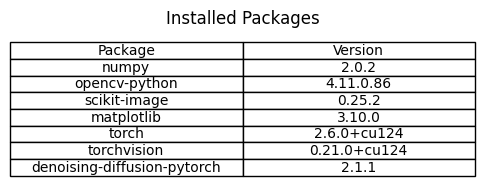

Please upload Barbara.jpg and bee_2.jpg


Saving bee_2.jpg to bee_2 (8).jpg
Saving Barbara.jpg to Barbara (8).jpg

Loaded Images:
     Image       Shape
0  Barbara  (512, 512)
1      Bee  (443, 590)


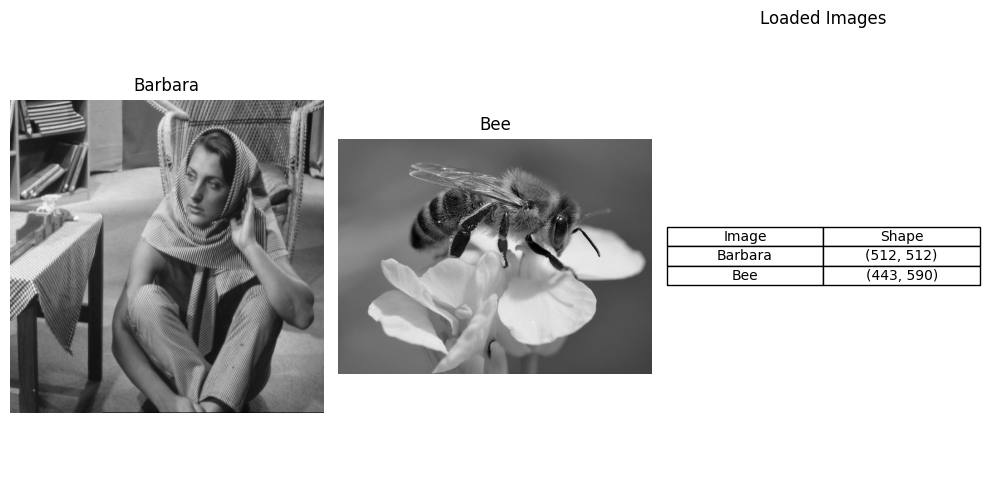


Noisy Image Metrics:
     Image  Sigma       PSNR      SSIM
0  Barbara     10  28.133204  0.702166
1  Barbara     20  22.138809  0.458086
2  Barbara     30  18.709436  0.320928
3  Barbara     40  16.358307  0.235414
4      Bee     10  28.147044  0.535732
5      Bee     20  22.207398  0.292109
6      Bee     30  18.795640  0.193403
7      Bee     40  16.426483  0.140473


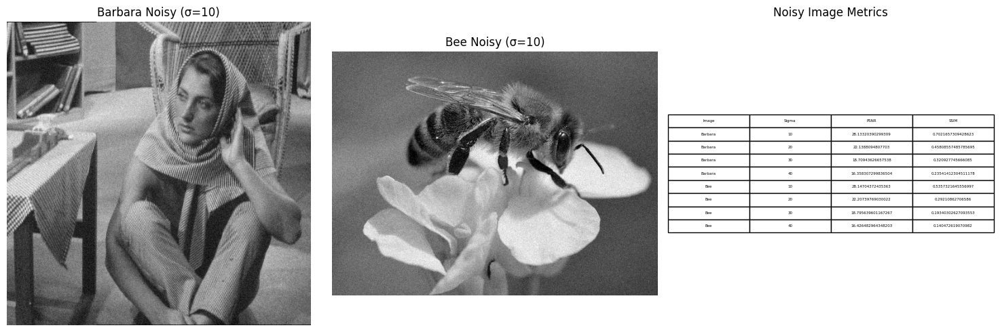

PDE Functions Defined: p, q, compute_gradient, double_phase_operator, solve_pde

PDE Function Descriptions:
                Function                      Description
0                      p  Computes variable exponent p(x)
1                      q  Computes variable exponent q(x)
2       compute_gradient       Calculates image gradients
3  double_phase_operator     Computes PDE flux divergence
4              solve_pde         Solves PDE for denoising


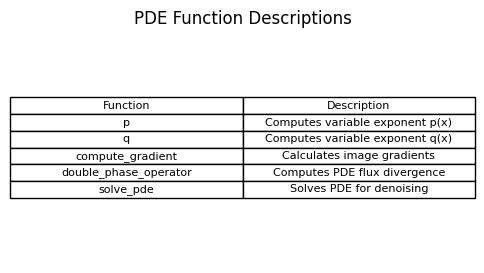

Processing Barbara, σ=10
Processing Barbara, σ=20
Processing Barbara, σ=30
Processing Barbara, σ=40
Processing Bee, σ=10
Processing Bee, σ=20
Processing Bee, σ=30
Processing Bee, σ=40

PDE Denoised Metrics:
     Image  Sigma       PSNR      SSIM
0  Barbara     10  12.700342  0.218338
1  Barbara     20  11.766708  0.170473
2  Barbara     30  10.955709  0.135115
3  Barbara     40  10.282543  0.109023
4      Bee     10  12.395362  0.108440
5      Bee     20  11.596614  0.087037
6      Bee     30  10.853809  0.071722
7      Bee     40  10.224638  0.060187


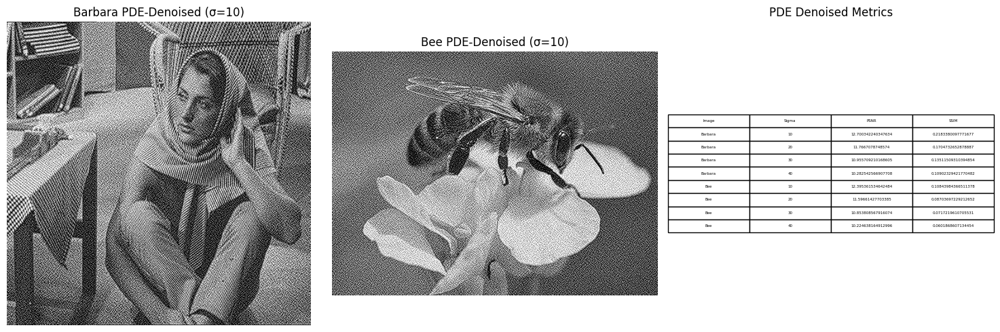

BSR Dataset loaded successfully

BSR Dataset Info:
     Dataset  Num Images                           Path
0  BSR Train         200  BSR/BSDS500/data/images/train


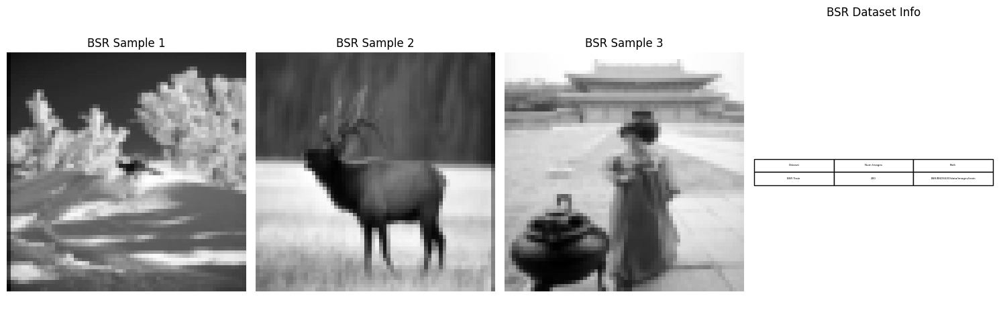

GPU Memory Allocated: 573.27 MB
GPU Memory Cached: 974.00 MB
Starting diffusion model training...


  0%|          | 0/500 [00:00<?, ?it/s]

/usr/lib/python3.11/contextlib.py:105: FutureWarning: `torch.backends.cuda.sdp_kernel()` is deprecated. In the future, this context manager will be removed. Please see `torch.nn.attention.sdpa_kernel()` for the new context manager, with updated signature.
  self.gen = func(*args, **kwds)


sampling loop time step:   0%|          | 0/100 [00:00<?, ?it/s]

sampling loop time step:   0%|          | 0/100 [00:00<?, ?it/s]

sampling loop time step:   0%|          | 0/100 [00:00<?, ?it/s]

sampling loop time step:   0%|          | 0/100 [00:00<?, ?it/s]

sampling loop time step:   0%|          | 0/100 [00:00<?, ?it/s]

sampling loop time step:   0%|          | 0/100 [00:00<?, ?it/s]

sampling loop time step:   0%|          | 0/100 [00:00<?, ?it/s]

sampling loop time step:   0%|          | 0/100 [00:00<?, ?it/s]

sampling loop time step:   0%|          | 0/100 [00:00<?, ?it/s]

sampling loop time step:   0%|          | 0/100 [00:00<?, ?it/s]

sampling loop time step:   0%|          | 0/100 [00:00<?, ?it/s]

sampling loop time step:   0%|          | 0/100 [00:00<?, ?it/s]

sampling loop time step:   0%|          | 0/100 [00:00<?, ?it/s]

sampling loop time step:   0%|          | 0/100 [00:00<?, ?it/s]

sampling loop time step:   0%|          | 0/100 [00:00<?, ?it/s]

sampling loop time step:   0%|          | 0/100 [00:00<?, ?it/s]

sampling loop time step:   0%|          | 0/100 [00:00<?, ?it/s]

sampling loop time step:   0%|          | 0/100 [00:00<?, ?it/s]

sampling loop time step:   0%|          | 0/100 [00:00<?, ?it/s]

sampling loop time step:   0%|          | 0/100 [00:00<?, ?it/s]

training complete
Diffusion model training completed.

Diffusion Model Summary:
   Component                                       Config
0      U-Net          dim=64, mults=(1,2,4,8), channels=1
1  Diffusion  image_size=64, timesteps=1000, sampling=100
2    Trainer                      batch_size=8, steps=500


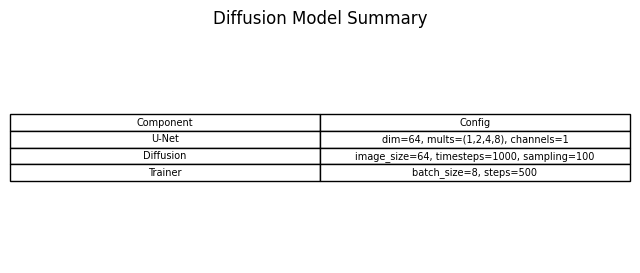

GPU Memory Allocated: 990.05 MB
GPU Memory Cached: 1158.00 MB
Preprocessed tensor shape: torch.Size([1, 1, 64, 64]), device: cuda:0
Inferring hybrid output for Barbara, σ=10
Sampling step 0, timestep: 999, type: <class 'int'>


/usr/lib/python3.11/contextlib.py:105: FutureWarning: `torch.backends.cuda.sdp_kernel()` is deprecated. In the future, this context manager will be removed. Please see `torch.nn.attention.sdpa_kernel()` for the new context manager, with updated signature.
  self.gen = func(*args, **kwds)


TypeError: clamp() received an invalid combination of arguments - got (tuple, float, float), but expected one of:
 * (Tensor input, Tensor min = None, Tensor max = None, *, Tensor out = None)
 * (Tensor input, Number min = None, Number max = None, *, Tensor out = None)


In [10]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from skimage.metrics import peak_signal_noise_ratio, structural_similarity, mean_squared_error
import os
import torch
from PIL import Image
from torch.utils.data import Dataset, DataLoader
import torchvision.transforms as transforms
import pandas as pd
from denoising_diffusion_pytorch import Unet, GaussianDiffusion, Trainer
import glob
import sys

# Enable inline plotting
%matplotlib inline

# Create output directories
os.makedirs("denoise_steps", exist_ok=True)
os.makedirs("comparisons", exist_ok=True)
os.makedirs("bsr_images", exist_ok=True)

# Verify GPU
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")

# Output: Table of installed packages
import pkg_resources
packages = ['numpy', 'opencv-python', 'scikit-image', 'matplotlib', 'torch', 'torchvision', 'denoising-diffusion-pytorch']
installed = {pkg: pkg_resources.get_distribution(pkg).version for pkg in packages}
df = pd.DataFrame(list(installed.items()), columns=['Package', 'Version'])
print("\nInstalled Packages:")
print(df)

# Plot table
plt.figure(figsize=(6, 2))
plt.table(cellText=df.values, colLabels=df.columns, loc='center', cellLoc='center')
plt.axis('off')
plt.title("Installed Packages")
plt.savefig("comparisons/step1_packages.png")
plt.show()

# Step 2: Upload and Load Images
from google.colab import files

# Upload Barbara and Bee images
print("Please upload Barbara.jpg and bee_2.jpg")
uploaded = files.upload()

# Define image paths
image_paths = {
    "Barbara": "/content/Barbara.jpg",
    "Bee": "/content/bee_2.jpg",
}

# Load images
images = {}
for name, path in image_paths.items():
    img = cv2.imread(path, cv2.IMREAD_GRAYSCALE)
    if img is None:
        print(f"Error: Failed to load {name} from {path}")
    else:
        images[name] = img

# Exit if no images loaded
if not images:
    print("Error: No images loaded. Exiting.")
    sys.exit(1)

# Output: Table of loaded images
df = pd.DataFrame([(name, img.shape) for name, img in images.items()], columns=['Image', 'Shape'])
print("\nLoaded Images:")
print(df)

# Visualize loaded images and table
plt.figure(figsize=(10, 5))
for i, (name, img) in enumerate(images.items(), 1):
    plt.subplot(1, len(images) + 1, i)
    plt.imshow(img, cmap='gray')
    plt.title(name)
    plt.axis('off')
plt.subplot(1, len(images) + 1, len(images) + 1)
plt.table(cellText=df.values, colLabels=df.columns, loc='center', cellLoc='center')
plt.axis('off')
plt.title("Loaded Images")
plt.tight_layout()
plt.savefig("comparisons/step2_images.png")
plt.show()

# Step 3: Normalize Images and Add Noise
sigma_noise_levels = [10, 20, 30, 40]
noisy_images = {}

# Normalize and add noise
for name in images:
    images[name] = images[name].astype(float) / 255.0
    noisy_images[name] = {}
    for sigma in sigma_noise_levels:
        scaled_sigma = sigma / 255.0
        noise = np.random.normal(0, scaled_sigma, images[name].shape)
        noisy_images[name][sigma] = np.clip(images[name] + noise, 0, 1)
        cv2.imwrite(f"noisy_{name}_sigma_{sigma}.png", (noisy_images[name][sigma] * 255).astype(np.uint8))

# Output: Table of noisy image metrics
metrics = []
for name in images:
    for sigma in sigma_noise_levels:
        psnr_val = peak_signal_noise_ratio(images[name], noisy_images[name][sigma], data_range=1.0)
        ssim_val = structural_similarity(images[name], noisy_images[name][sigma], data_range=1.0)
        metrics.append([name, sigma, psnr_val, ssim_val])
df = pd.DataFrame(metrics, columns=['Image', 'Sigma', 'PSNR', 'SSIM'])
print("\nNoisy Image Metrics:")
print(df)

# Visualize noisy images and table (example for σ=10)
plt.figure(figsize=(15, 5))
for i, name in enumerate(images, 1):
    plt.subplot(1, len(images) + 1, i)
    plt.imshow(noisy_images[name][10], cmap='gray')
    plt.title(f"{name} Noisy (σ=10)")
    plt.axis('off')
plt.subplot(1, len(images) + 1, len(images) + 1)
plt.table(cellText=df.values, colLabels=df.columns, loc='center', cellLoc='center')
plt.axis('off')
plt.title("Noisy Image Metrics")
plt.tight_layout()
plt.savefig("comparisons/step3_noisy_metrics.png")
plt.show()

# Step 4: Define PDE Denoising Functions
def p(x, k1):
    return 1 + 1 / (1 + k1 * np.linalg.norm(x)**2)

def q(x, k2):
    return 1 + 1 / (1 + k2 * np.linalg.norm(x)**2)

def compute_gradient(u):
    grad_x = np.gradient(u, axis=1)
    grad_y = np.gradient(u, axis=0)
    return grad_x, grad_y

def double_phase_operator(u, X, Y, k1, k2):
    grad_x, grad_y = compute_gradient(u)
    grad_norm = np.sqrt(grad_x**2 + grad_y**2 + 1e-4)
    p_vals = p(np.stack([X, Y], axis=-1), k1)
    q_vals = q(np.stack([X, Y], axis=-1), k2)
    flux_x = (grad_norm**(p_vals-2) + grad_norm**(q_vals-2)) * grad_x
    flux_y = (grad_norm**(p_vals-2) + grad_norm**(q_vals-2)) * grad_y
    div_x = np.gradient(flux_x, axis=1)
    div_y = np.gradient(flux_y, axis=0)
    return div_x + div_y

def solve_pde(noisy_image, k1=1.0, k2=1.0, T=0.1, dt=0.00005, h=1.0, image_name="", sigma=0):
    u = noisy_image.copy()
    height, width = u.shape
    x = np.arange(0, width, h)
    y = np.arange(0, height, h)
    X, Y = np.meshgrid(x, y)
    num_iterations = int(T / dt)
    prev_u = u.copy()

    for t in range(num_iterations):
        diffusion_term = double_phase_operator(u, X, Y, k1, k2)
        u -= dt * diffusion_term
        u = np.clip(u, 0, 1)
        if np.any(np.isnan(u)) or np.any(np.isinf(u)):
            print(f"Warning: Invalid values at iteration {t} for {image_name}, σ={sigma}")
            return u
        if t % 100 == 0 and t > 0:
            diff = np.mean(np.abs(u - prev_u))
            if diff < 1e-4:
                print(f"Early stopping at iteration {t} for {image_name}, σ={sigma}")
                break
            prev_u = u.copy()
        if t % 500 == 0:
            plt.figure(figsize=(5, 5))
            plt.imshow(u, cmap='gray')
            plt.title(f"{image_name}, σ={sigma}, Iteration {t}")
            plt.axis('off')
            plt.savefig(f"denoise_steps/denoise_{image_name}_sigma_{sigma}_iter_{t}.png")
            plt.close()

    cv2.imwrite(f"denoise_{image_name}_sigma_{sigma}_pde.png", (u * 255).astype(np.uint8))
    return u

# Output: Function definitions
print("PDE Functions Defined: p, q, compute_gradient, double_phase_operator, solve_pde")

# Visualize function descriptions (table)
df = pd.DataFrame([
    ['p', 'Computes variable exponent p(x)'],
    ['q', 'Computes variable exponent q(x)'],
    ['compute_gradient', 'Calculates image gradients'],
    ['double_phase_operator', 'Computes PDE flux divergence'],
    ['solve_pde', 'Solves PDE for denoising']
], columns=['Function', 'Description'])
print("\nPDE Function Descriptions:")
print(df)

plt.figure(figsize=(6, 3))
plt.table(cellText=df.values, colLabels=df.columns, loc='center', cellLoc='center')
plt.axis('off')
plt.title("PDE Function Descriptions")
plt.savefig("comparisons/step4_functions.png")
plt.show()

# Step 5: Apply PDE Denoising
pde_denoised_images = {}
for name in images:
    pde_denoised_images[name] = {}
    for sigma in sigma_noise_levels:
        print(f"Processing {name}, σ={sigma}")
        pde_denoised_images[name][sigma] = solve_pde(
            noisy_images[name][sigma], k1=1.0, k2=1.0, T=0.1, dt=0.00005,
            image_name=name, sigma=sigma
        )

# Output: Table of PDE denoising metrics
metrics = []
for name in images:
    for sigma in sigma_noise_levels:
        psnr_val = peak_signal_noise_ratio(images[name], pde_denoised_images[name][sigma], data_range=1.0)
        ssim_val = structural_similarity(images[name], pde_denoised_images[name][sigma], data_range=1.0)
        metrics.append([name, sigma, psnr_val, ssim_val])
df = pd.DataFrame(metrics, columns=['Image', 'Sigma', 'PSNR', 'SSIM'])
print("\nPDE Denoised Metrics:")
print(df)

# Visualize PDE-denoised images (σ=10) and table
plt.figure(figsize=(15, 5))
for i, name in enumerate(images, 1):
    plt.subplot(1, len(images) + 1, i)
    plt.imshow(pde_denoised_images[name][10], cmap='gray')
    plt.title(f"{name} PDE-Denoised (σ=10)")
    plt.axis('off')
plt.subplot(1, len(images) + 1, len(images) + 1)
plt.table(cellText=df.values, colLabels=df.columns, loc='center', cellLoc='center')
plt.axis('off')
plt.title("PDE Denoised Metrics")
plt.tight_layout()
plt.savefig("comparisons/step5_pde_metrics.png")
plt.show()

# Step 6: Prepare Images for Diffusion Model
# Download and extract BSR dataset
try:
    if not os.path.exists('BSR_bsds500.tgz'):
        !wget https://www2.eecs.berkeley.edu/Research/Projects/CS/vision/grouping/BSR/BSR_bsds500.tgz
    if not os.path.exists('BSR'):
        !tar xzf BSR_bsds500.tgz
    print("BSR Dataset loaded successfully")
except Exception as e:
    print(f"Error loading dataset: {e}")
    sys.exit(1)

# Custom dataset class
class BSRDataset(Dataset):
    def __init__(self, root_dir, transform=None):
        self.image_paths = glob.glob(os.path.join(root_dir, '*.jpg'))
        self.transform = transform
    def __len__(self):
        return len(self.image_paths)
    def __getitem__(self, idx):
        img_path = self.image_paths[idx]
        image = Image.open(img_path).convert('L')  # Grayscale
        if self.transform:
            image = self.transform(image)
        return image

# Define transforms (64x64)
transform = transforms.Compose([
    transforms.Resize((64, 64)),
    transforms.ToTensor()
])

# Load BSR dataset (train folder)
bsr_train_path = 'BSR/BSDS500/data/images/train'
train_dataset = BSRDataset(bsr_train_path, transform=transform)
train_dataloader = DataLoader(train_dataset, batch_size=8, shuffle=True)

# Save transformed images to bsr_images for diffusion
os.makedirs("bsr_images", exist_ok=True)
for i, img in enumerate(train_dataset):
    img_np = img.squeeze().numpy() * 255.0
    Image.fromarray(img_np.astype(np.uint8)).save(f"bsr_images/train_{i}.png")

# Output: Table of dataset info
num_images = len(train_dataset)
df = pd.DataFrame([
    ['BSR Train', num_images, bsr_train_path]
], columns=['Dataset', 'Num Images', 'Path'])
print("\nBSR Dataset Info:")
print(df)

# Visualize sample BSR images and table
sample_images = [train_dataset[i] for i in range(min(3, num_images))]
plt.figure(figsize=(15, 5))
for i in range(len(sample_images)):
    plt.subplot(1, 4, i + 1)
    plt.imshow(sample_images[i].squeeze(), cmap='gray')
    plt.title(f"BSR Sample {i+1}")
    plt.axis('off')
plt.subplot(1, 4, 4)
plt.table(cellText=df.values, colLabels=df.columns, loc='center', cellLoc='center')
plt.axis('off')
plt.title("BSR Dataset Info")
plt.tight_layout()
plt.savefig("comparisons/step6_bsr_info.png")
plt.show()

# Step 7: Train Diffusion Model
# Clear GPU memory
torch.cuda.empty_cache()
print(f"GPU Memory Allocated: {torch.cuda.memory_allocated() / 1024**2:.2f} MB")
print(f"GPU Memory Cached: {torch.cuda.memory_reserved() / 1024**2:.2f} MB")

try:
    model = Unet(
        dim=64,
        dim_mults=(1, 2, 4, 8),
        flash_attn=True,
        channels=1  # Grayscale
    )

    diffusion = GaussianDiffusion(
        model,
        image_size=64,
        timesteps=1000,
        sampling_timesteps=100
    )

    trainer = Trainer(
        diffusion,
        'bsr_images',
        train_batch_size=8,
        train_lr=8e-5,
        train_num_steps=500,
        gradient_accumulate_every=2,
        ema_decay=0.995,
        amp=True,
        calculate_fid=False,
        save_and_sample_every=100
    )

    print("Starting diffusion model training...")
    trainer.train()
    print("Diffusion model training completed.")
except RuntimeError as e:
    print(f"Training failed due to: {e}")
    print("Try reducing batch_size, model dimensions, or image size further.")
    sys.exit(1)

# Output: Function for diffusion model summary
def diffusion_summary():
    return pd.DataFrame([
        ['U-Net', 'dim=64, mults=(1,2,4,8), channels=1'],
        ['Diffusion', 'image_size=64, timesteps=1000, sampling=100'],
        ['Trainer', 'batch_size=8, steps=500']
    ], columns=['Component', 'Config'])

df = diffusion_summary()
print("\nDiffusion Model Summary:")
print(df)

plt.figure(figsize=(8, 3))
plt.table(cellText=df.values, colLabels=df.columns, loc='center', cellLoc='center')
plt.axis('off')
plt.title("Diffusion Model Summary")
plt.savefig("comparisons/step7_diffusion_summary.png")
plt.show()

# Step 8: Hybrid Inference and Visualization
# Preprocess function for diffusion model (64x64)
def preprocess_for_diffusion(image, size=64):
    img = Image.fromarray((image * 255).astype(np.uint8)).convert('L')
    img = img.resize((size, size), Image.LANCZOS)
    img = np.array(img).astype(np.float32) / 255.0
    img = (img * 2.0) - 1.0  # Normalize to [-1, 1]
    img = torch.from_numpy(img).unsqueeze(0).unsqueeze(0).to(device)
    print(f"Preprocessed tensor shape: {img.shape}, device: {img.device}")
    return img

# Custom sampling function to start from PDE-denoised image
def custom_sample(diffusion, x, num_steps):
    diffusion.model.eval()
    with torch.no_grad():
        # Get timesteps for sampling
        timesteps = torch.linspace(diffusion.num_timesteps - 1, 0, steps=num_steps + 1, device=device).long()
        img = x  # Start from PDE-denoised image
        for i in range(num_steps):
            t = int(timesteps[i].item())  # Convert to scalar integer
            print(f"Sampling step {i}, timestep: {t}, type: {type(t)}")  # Debug timestep
            # Denoise one step
            img = diffusion.p_sample(img, t)
            # Clip to ensure valid pixel values
            img = torch.clamp(img, -1.0, 1.0)
        # Convert back to [0, 1]
        img = (img + 1.0) / 2.0
        return img

# Hybrid inference and visualization
results = {}
diffusion.model.to(device)
diffusion.model.eval()
torch.cuda.empty_cache()
print(f"GPU Memory Allocated: {torch.cuda.memory_allocated() / 1024**2:.2f} MB")
print(f"GPU Memory Cached: {torch.cuda.memory_reserved() / 1024**2:.2f} MB")

try:
    for name in images:
        results[name] = {}
        for sigma in sigma_noise_levels:
            noisy_img = noisy_images[name][sigma]
            pde_img = pde_denoised_images[name][sigma]
            clean_img = images[name]
            # Diffusion inference
            pde_img_resized = preprocess_for_diffusion(pde_img)
            print(f"Inferring hybrid output for {name}, σ={sigma}")
            with torch.no_grad():
                hybrid_img = custom_sample(diffusion, pde_img_resized, num_steps=diffusion.sampling_timesteps)
            hybrid_img = hybrid_img.squeeze().cpu().numpy()
            print(f"Hybrid output shape: {hybrid_img.shape}")
            # Resize back to original size
            hybrid_img_pil = Image.fromarray((hybrid_img * 255).astype(np.uint8))
            hybrid_img_pil = hybrid_img_pil.resize((clean_img.shape[1], clean_img.shape[0]), Image.LANCZOS)
            hybrid_img = np.array(hybrid_img_pil).astype(np.float32) / 255.0
            # Metrics
            results[name][sigma] = {
                "Noisy": {
                    "PSNR": peak_signal_noise_ratio(clean_img, noisy_img, data_range=1.0),
                    "SSIM": structural_similarity(clean_img, noisy_img, data_range=1.0)
                },
                "PDE": {
                    "PSNR": peak_signal_noise_ratio(clean_img, pde_img, data_range=1.0),
                    "SSIM": structural_similarity(clean_img, pde_img, data_range=1.0)
                },
                "Hybrid": {
                    "PSNR": peak_signal_noise_ratio(clean_img, hybrid_img, data_range=1.0),
                    "SSIM": structural_similarity(clean_img, hybrid_img, data_range=1.0)
                }
            }
            # Visualize
            plt.figure(figsize=(20, 5))
            plt.subplot(1, 4, 1)
            plt.imshow(clean_img, cmap='gray')
            plt.title(f"{name} Original")
            plt.axis('off')
            plt.subplot(1, 4, 2)
            plt.imshow(noisy_img, cmap='gray')
            plt.title(f"{name} Noisy (σ={sigma})")
            plt.axis('off')
            plt.subplot(1, 4, 3)
            plt.imshow(pde_img, cmap='gray')
            plt.title(f"{name} PDE-Denoised")
            plt.axis('off')
            plt.subplot(1, 4, 4)
            plt.imshow(hybrid_img, cmap='gray')
            plt.title(f"{name} Hybrid-Denoised")
            plt.axis('off')
            plt.tight_layout()
            plt.savefig(f"comparisons/comparison_{name}_sigma_{sigma}.png")
            plt.show()
except RuntimeError as e:
    print(f"Inference failed due to: {e}")
    print("Try reducing sampling_timesteps, batch_size, or image size further.")
    sys.exit(1)

# Output: Table of final metrics
metrics = []
for name in results:
    for sigma in results[name]:
        for method in results[name][sigma]:
            metrics.append([name, sigma, method, results[name][sigma][method]['PSNR'], results[name][sigma][method]['SSIM']])
df = pd.DataFrame(metrics, columns=['Image', 'Sigma', 'Method', 'PSNR', 'SSIM'])
print("\nFinal Denoising Metrics:")
print(df)

plt.figure(figsize=(10, 8))
plt.table(cellText=df.values, colLabels=df.columns, loc='center', cellLoc='center')
plt.axis('off')
plt.title("Final Denoising Metrics")
plt.savefig("comparisons/step8_final_metrics.png")
plt.show()

In [11]:
!pip install denoising-diffusion-pytorch==2.1.1